# **A hybrid classification model based on clustering: Parking Birmingham dataset**
### **In this notebook I will try to do an exploratory data analysis, clustering and finally classification based on clustering for the Parking Birmingham dataset, found in the UCI machine learning repository.**

<h1 id="Exploratory_Data_Analysis">
1. Exploratory Data Analysis
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#Exploratory_Data_Analysis">¶</a>
</h1>

In [1]:
import numpy as np
import pandas as pd
import os 

data = pd.read_csv('/Users/johnmantios1/Desktop/Διπλωματική/parking Birmingham/parking_Birmingham.csv')

data

,SystemCodeNumber,Capacity,Occupancy,LastUpdated
0,BHMBCCMKT01,577,61,2016-10-04 07:59:42
1,BHMBCCMKT01,577,64,2016-10-04 08:25:42
2,BHMBCCMKT01,577,80,2016-10-04 08:59:42
3,BHMBCCMKT01,577,107,2016-10-04 09:32:46
4,BHMBCCMKT01,577,150,2016-10-04 09:59:48
...,...,...,...,...
35712,Shopping,1920,1517,2016-12-19 14:30:33
35713,Shopping,1920,1487,2016-12-19 15:03:34
35714,Shopping,1920,1432,2016-12-19 15:29:33
35715,Shopping,1920,1321,2016-12-19 16:03:35


In [2]:
data.describe()

,Capacity,Occupancy
count,35717.000000,35717.000000
mean,1397.550130,642.228911
std,1179.326833,656.955535
min,220.000000,-8.000000
25%,500.000000,210.000000
50%,849.000000,446.000000
75%,2009.000000,798.000000
max,4675.000000,4327.000000


We will drop any negative values as they don't make sense

In [3]:
data = data[data['Capacity']>= 0 ]
data = data[data['Occupancy'] >=0]
false_data = data[data['Capacity'] < data['Occupancy']]
data = pd.concat([data, false_data]).drop_duplicates(keep=False)
data.describe()

,Capacity,Occupancy
count,34956.00000,34956.000000
mean,1409.02712,647.287333
std,1183.40644,661.201046
min,220.00000,0.000000
25%,577.00000,211.000000
50%,863.00000,452.000000
75%,2009.00000,802.000000
max,4675.00000,4327.000000


In [4]:
data.isnull().sum()

SystemCodeNumber    0
Capacity            0
Occupancy           0
LastUpdated         0
dtype: int64

In [5]:
np.average(data['Occupancy'])

647.2873326467559

In [6]:
data['SystemCodeNumber'].unique()

array(['BHMBCCMKT01', 'BHMBCCPST01', 'BHMBCCSNH01', 'BHMBCCTHL01',
       'BHMBRCBRG01', 'BHMBRCBRG02', 'BHMBRCBRG03', 'BHMBRTARC01',
       'BHMEURBRD01', 'BHMEURBRD02', 'BHMMBMMBX01', 'BHMNCPHST01',
       'BHMNCPLDH01', 'BHMNCPNHS01', 'BHMNCPNST01', 'BHMNCPPLS01',
       'BHMNCPRAN01', 'Broad Street', 'Bull Ring', 'NIA Car Parks',
       'NIA North', 'NIA South', 'Others-CCCPS105a', 'Others-CCCPS119a',
       'Others-CCCPS133', 'Others-CCCPS135a', 'Others-CCCPS202',
       'Others-CCCPS8', 'Others-CCCPS98', 'Shopping'], dtype=object)

In [7]:
from datetime import datetime as dt

data['OccupancyRate'] = data['Occupancy']*100/data['Capacity']

dateTime = data['LastUpdated'].str.split(" ", n=1 ,expand=True )

date = dateTime[0]
time = dateTime[1]
data['Date'] = date
data['Time'] = time
day_name = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']


data['DayOfWeek'] = pd.to_datetime(data['Date']).dt.dayofweek.apply(lambda x: day_name[x])

In [8]:
data

,SystemCodeNumber,Capacity,Occupancy,LastUpdated,OccupancyRate,Date,Time,DayOfWeek
0,BHMBCCMKT01,577,61,2016-10-04 07:59:42,10.571924,2016-10-04,07:59:42,Tue
1,BHMBCCMKT01,577,64,2016-10-04 08:25:42,11.091854,2016-10-04,08:25:42,Tue
2,BHMBCCMKT01,577,80,2016-10-04 08:59:42,13.864818,2016-10-04,08:59:42,Tue
3,BHMBCCMKT01,577,107,2016-10-04 09:32:46,18.544194,2016-10-04,09:32:46,Tue
4,BHMBCCMKT01,577,150,2016-10-04 09:59:48,25.996534,2016-10-04,09:59:48,Tue
...,...,...,...,...,...,...,...,...
35712,Shopping,1920,1517,2016-12-19 14:30:33,79.010417,2016-12-19,14:30:33,Mon
35713,Shopping,1920,1487,2016-12-19 15:03:34,77.447917,2016-12-19,15:03:34,Mon
35714,Shopping,1920,1432,2016-12-19 15:29:33,74.583333,2016-12-19,15:29:33,Mon
35715,Shopping,1920,1321,2016-12-19 16:03:35,68.802083,2016-12-19,16:03:35,Mon


In [9]:
data['Time'].max()

'16:34:28'

We will encode each day to a certain integer

In [10]:
data = data.replace({'Mon': 1, 'Tue': 2, 'Wed': 3, 'Thu': 4, 'Fri': 5, 'Sat': 6, 'Sun': 7})

We are going to encode the time range: from 07:30-10:59 will be 1, from 11:00-13:59 will be 2 and from 14:00-16:35 will be 3

In [11]:
for i in data.index:
    if data.at[i,'Time'][0:2] == '07' or  data.at[i,'Time'][0:2] == '08':
        data.at[i, 'Time'] = 1
    elif data.at[i,'Time'][0:2] == '09' or  data.at[i,'Time'][0:2] == '10': 
        data.at[i, 'Time'] = 2
    elif data.at[i,'Time'][0:2] == '11' or  data.at[i,'Time'][0:2] == '12': 
        data.at[i, 'Time'] = 3 
    elif data.at[i,'Time'][0:2] == '13' or  data.at[i,'Time'][0:2] == '14': 
        data.at[i, 'Time'] = 4         
    else:
        data.at[i, 'Time'] = 5

 

In [12]:
data['Time'].unique()

array([1, 2, 3, 4, 5], dtype=object)

In [13]:
data

,SystemCodeNumber,Capacity,Occupancy,LastUpdated,OccupancyRate,Date,Time,DayOfWeek
0,BHMBCCMKT01,577,61,2016-10-04 07:59:42,10.571924,2016-10-04,1,2
1,BHMBCCMKT01,577,64,2016-10-04 08:25:42,11.091854,2016-10-04,1,2
2,BHMBCCMKT01,577,80,2016-10-04 08:59:42,13.864818,2016-10-04,1,2
3,BHMBCCMKT01,577,107,2016-10-04 09:32:46,18.544194,2016-10-04,2,2
4,BHMBCCMKT01,577,150,2016-10-04 09:59:48,25.996534,2016-10-04,2,2
...,...,...,...,...,...,...,...,...
35712,Shopping,1920,1517,2016-12-19 14:30:33,79.010417,2016-12-19,4,1
35713,Shopping,1920,1487,2016-12-19 15:03:34,77.447917,2016-12-19,5,1
35714,Shopping,1920,1432,2016-12-19 15:29:33,74.583333,2016-12-19,5,1
35715,Shopping,1920,1321,2016-12-19 16:03:35,68.802083,2016-12-19,5,1


In [14]:
import plotly.express as px
import plotly.graph_objects as go

xdata = data.groupby('SystemCodeNumber')['OccupancyRate'].mean()

key_list = list(xdata.keys())
val_list = []

for x in key_list:
    val_list.append(xdata[x])
    
df = pd.DataFrame(list(zip(key_list, val_list))  , columns =['Park ID', 'Mean Occupancy Rate']  )
fig = px.bar(df, x='Park ID', y='Mean Occupancy Rate')
fig.show()

In [15]:
data.shape

(34956, 8)

In [16]:
data = data.drop_duplicates()

In [17]:
data.shape

(34956, 8)

In [18]:
cluster_data = data.copy()

In [19]:
cluster_data = cluster_data.drop(columns = ['SystemCodeNumber','Occupancy', 'LastUpdated','Date', 'Capacity'])

In [20]:
cluster_data

,OccupancyRate,Time,DayOfWeek
0,10.571924,1,2
1,11.091854,1,2
2,13.864818,1,2
3,18.544194,2,2
4,25.996534,2,2
...,...,...,...
35712,79.010417,4,1
35713,77.447917,5,1
35714,74.583333,5,1
35715,68.802083,5,1


In [21]:
from sklearn.preprocessing import StandardScaler

cluster_data = StandardScaler().fit_transform(cluster_data)

In [22]:
data = pd.DataFrame(cluster_data, columns=['OccupancyRate','Time','Day'])

In [23]:
data

,OccupancyRate,Time,Day
0,-1.446365,-1.625080,-0.938197
1,-1.426852,-1.625080,-0.938197
2,-1.322786,-1.625080,-0.938197
3,-1.147175,-0.867955,-0.938197
4,-0.867497,-0.867955,-0.938197
...,...,...,...
34951,1.122052,0.646294,-1.440596
34952,1.063413,1.403418,-1.440596
34953,0.955908,1.403418,-1.440596
34954,0.738945,1.403418,-1.440596


In [24]:
data = data.drop_duplicates()

<h1 id="Clustering">
2. Clustering
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#Clustering">¶</a>
</h1>

Let's assess the clusterability of the dataset using the hopkins statistic. According to the pyclustertend library, on a scale from 0 to 1, the lower the score, the better the clusterability of the dataset

In [25]:
from pyclustertend import hopkins 

hopkins(data, data.shape[0])

0.008274173483962744

This score looks quite promising

<h1 id="agglomerative">
2.1 Agglomerative Clustering
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#agglomerative">¶</a>
</h1>

We begin the clustering process with the agglomerative clustering algorithm for one simple reason: it is a hierarchical clustering algorithm, so we simplify the problem of having to choose beforehand the number of clusters in our model.Hierarchical clustering does not avoid the problem with choosing the number of clusters. Simply - it constructs the tree spaning over all samples, which shows which samples (later on - clusters) merge together to create a bigger cluster. This happens recursively till you have just two clusters (this is why the default number of clusters is 2) which are merged to the whole dataset.

Firstly, we are going to determine which linkage method to use. In order to do that we will calculate the cophenet index. Cophenet index is a measure of the correlation between the distance of points in feature space and distance on the dendrogram. If the distance between these points increases as the dendrogram distance between the clusters does then the Cophenet index is closer to 1. So, values closer to 1 mean a better linkage method.

In [26]:
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster import hierarchy
from sklearn.cluster import AgglomerativeClustering
from scipy.spatial.distance import pdist
import plotly.graph_objects as go

Z = hierarchy.linkage(data, 'ward')

c, coph_dists = hierarchy.cophenet(Z, pdist(data, 'hamming'))

ward = c


A = hierarchy.linkage(data,'average')

c, coph_dists = hierarchy.cophenet(A, pdist(data, 'hamming'))

average = c


B = hierarchy.linkage(data,'single')

c, coph_dists = hierarchy.cophenet(B, pdist(data, 'hamming'))

single = c


C = hierarchy.linkage(data,'complete')

c, coph_dists = hierarchy.cophenet(C, pdist(data, 'hamming'))

complete = c


D = hierarchy.linkage(data,'weighted')

c, coph_dists = hierarchy.cophenet(D, pdist(data, 'hamming'))

weighted = c


E = hierarchy.linkage(data,'centroid')

c, coph_dists = hierarchy.cophenet(E, pdist(data, 'hamming'))

centroid = c

F = hierarchy.linkage(data,'median')

c, coph_dists = hierarchy.cophenet(F, pdist(data, 'hamming'))

median = c


metrics=['ward', 'average', 'single', 'complete', 'weighted', 'centroid', 'median']


fig = go.Figure([go.Bar(x=metrics, y=[ward, average, single, complete, weighted, centroid, median])])
fig.show()




We clearly see that the single linkage method is the preferred one.

Let's calculate some useful metrics that will help us decide the number of clusters. Since the ground truth labels are not known we will use such metrics like the silhouette coefficient, the Davies-Bouldin score and the Calinski-Harabasz Index.

In [28]:
from sklearn.metrics import silhouette_score
for n_clusters in range(2,6):
    clusterer = AgglomerativeClustering (n_clusters=n_clusters, distance_threshold = None)
    preds = clusterer.fit_predict(data)
    

    score = silhouette_score (data, preds)
    print ("For n_clusters = {}, silhouette score is {})".format(n_clusters, score))

For n_clusters = 2, silhouette score is 0.28581817091772854)
For n_clusters = 3, silhouette score is 0.24487098816880482)
For n_clusters = 4, silhouette score is 0.24249318219520183)
For n_clusters = 5, silhouette score is 0.23676923997474006)


Let's check the Davies-Bouldin score.We want a values as close to 0 as possible

In [29]:
from sklearn.metrics import davies_bouldin_score

for n_clusters in range(2,6):
    clusterer = AgglomerativeClustering (n_clusters=n_clusters, distance_threshold = None)
    preds = clusterer.fit_predict(data)
    
    score = davies_bouldin_score (data , preds)
    print ("For n_clusters = {}, the Davies-Bouldin score is {})".format(n_clusters, score))

For n_clusters = 2, the Davies-Bouldin score is 1.337812475440612)
For n_clusters = 3, the Davies-Bouldin score is 1.5155138201618084)
For n_clusters = 4, the Davies-Bouldin score is 1.3076706056941734)
For n_clusters = 5, the Davies-Bouldin score is 1.1090234014329883)


Calinski-Harabasz index.We want as high a score as possible

In [30]:
from sklearn.metrics import calinski_harabasz_score

for n_clusters in range(2,6):
    clusterer = AgglomerativeClustering (n_clusters=n_clusters, distance_threshold = None)
    preds = clusterer.fit_predict(data)
    
    score = calinski_harabasz_score(data, preds)
    print ("For n_clusters = {}, the Calinski-Harabasz score is {})".format(n_clusters, score))

For n_clusters = 2, the Calinski-Harabasz score is 13412.217310385502)
For n_clusters = 3, the Calinski-Harabasz score is 11581.716362741914)
For n_clusters = 4, the Calinski-Harabasz score is 11632.189887921753)
For n_clusters = 5, the Calinski-Harabasz score is 12046.745957993508)


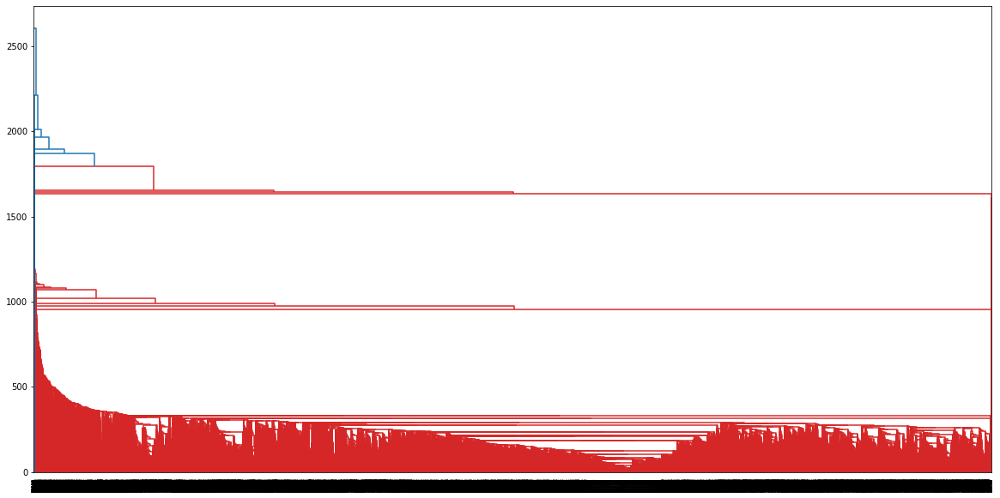

In [31]:
import matplotlib.pyplot as plt
%matplotlib inline

model = AgglomerativeClustering(distance_threshold=0, n_clusters = None)
model = model.fit(data)

Z = hierarchy.linkage(model.children_, 'single')

plt.figure(figsize=(20,10))

dn = hierarchy.dendrogram(Z)

From the dendrogram we observe that it is going to be either 2 or 3 clusters

Now, let's plot our data using the labels that the algorithm generated.We are going to make a scatterplot.

In [32]:
import seaborn as sns
import plotly.express as px

model = AgglomerativeClustering(distance_threshold=None, n_clusters = 3)
model = model.fit(data)
y_agg=model.fit_predict(data)




In [33]:
data_agg = data.copy()

data_agg['Agg_Labels'] = y_agg

fig = px.scatter_3d(data_agg, x='OccupancyRate', y='Time', z='Day',
              color= 'Agg_Labels')
fig.show()

<h1 id="DBSCAN">
2.2 DBSCAN
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#DBSCAN">¶</a>
</h1>

Following, we apply to our data set the DBSCAN algorithm.DBSCAN works by running a connected components algorithm across the different core points. If two core points share border points, or a core point is a border point in another core point’s neighborhood, then they’re part of the same connected component, which forms a cluster.
A low min_samples parameter means it will build more clusters from noise, so we shouldn't choose it too small.
The DBSCAN paper suggests to choose minPts based on the dimensionality, and eps based on the elbow in the k-distance graph.
For eps, we can try to do a knn distance histogram and choose a "knee" there, but there might be no visible one, or multiple.

In the more recent publication

Schubert, E., Sander, J., Ester, M., Kriegel, H. P., & Xu, X. (2017).
DBSCAN Revisited, Revisited: Why and How You Should (Still) Use DBSCAN.
ACM Transactions on Database Systems (TODS), 42(3), 19.


The authors suggest to use a larger minpts for large and noisy data sets, and to adjust epsilon depending on whether you get too large clusters (decrease epsilon) or too much noise (increase epsilon). Clustering requires iterations.

Let's apply the Knee method using KNN to find the optimal eps value for our model. Since KNN is a supervised learning algorithm and our data is not labeled, we will apply a general rule of thumb popularized by the "Pattern Classification" book by Duda et al., saying that the optimal K value usually found is the square root of N, where N is the total number of samples.

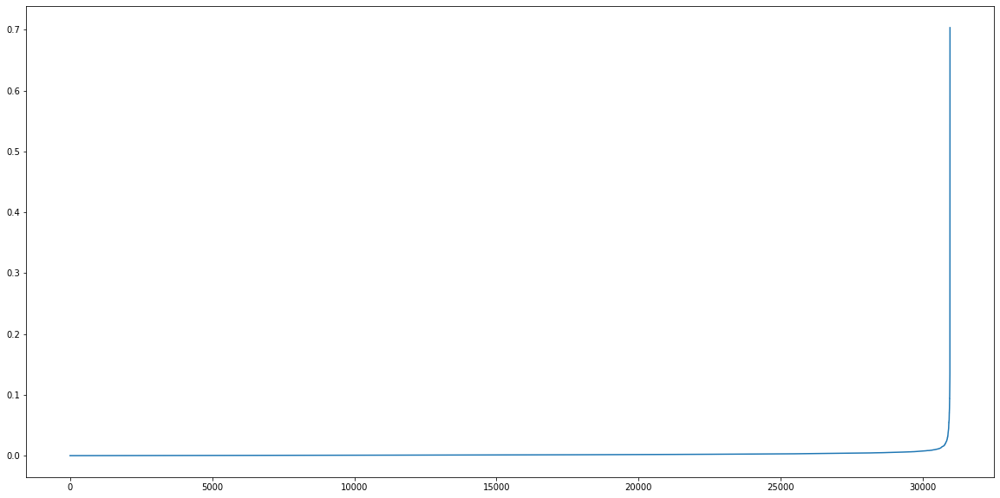

In [34]:
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt

nearest_neighbors = NearestNeighbors(n_neighbors=187) #sqrt(samples = 34956)
nearest_neighbors.fit(data)
distances, indices = nearest_neighbors.kneighbors(data)
distances = np.sort(distances, axis=0)[:, 1]
#print(distances)
plt.figure(figsize=(20,10))
plt.plot(distances)
plt.show()

Optimal value for eps where a 'knee' is formed is 0.1.

A general rule of thumb is ==> Min points ≥dimensionality +1.After some trial and error, the min_samples value will be 36, as it will produce small number of big clusters  


In [80]:
from sklearn.cluster import DBSCAN

model2 = DBSCAN(eps = 0.02, min_samples = 36)
model2 = model2.fit(data)

y_db=model2.labels_

data_DB = data.copy()
data_DB["DB_Labels"] = y_db

data_DB["DB_Labels"].value_counts(0)

-1    30634
 0      146
 3       82
 2       55
 1       36
Name: DB_Labels, dtype: int64

In [81]:
import plotly.express as px

data_DB = data.copy()

data_DB['DB_Labels'] = model2.labels_

fig = px.scatter_3d(data_DB, x='OccupancyRate', y='Time', z='Day',
              color= 'DB_Labels')
fig.show()

In [82]:
data_DB_filtered = data_DB.copy()

# Get names of indexes for which column DB_Labels has value -1
indexNames = data_DB_filtered[ data_DB_filtered['DB_Labels'] == -1 ].index
# Delete these row indexes from dataFrame
data_DB_filtered.drop(indexNames , inplace=True)

data_DB_filtered['DB_Labels'].unique()

array([1, 0, 2, 3])

In [83]:
#plot clustered data without noise

fig = px.scatter_3d(data_DB_filtered, x='OccupancyRate', y='Time', z='Day',
              color= 'DB_Labels')
fig.show()

<h1 id="EM">
2.3 EM using GMM
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#EM">¶</a>
</h1>

At its simplest, GMM is also a type of clustering algorithm. As its name implies, each cluster is modelled according to a different Gaussian distribution. This flexible and probabilistic approach to modelling the data means that rather than having hard assignments into clusters like k-means, we have soft assignments. This means that each data point could have been generated by any of the distributions with a corresponding probability.

Let's calculate the silhouette score for various number of n_components

In [39]:
from sklearn.mixture import GaussianMixture as GMM

for n_components in range(2,8):
    clusterer = GMM(n_components=n_components)
    preds = clusterer.fit_predict(data)
    

    score = silhouette_score (data, preds)
    print ("For n_clusters = {}, silhouette score is {})".format(n_components, score))

For n_clusters = 2, silhouette score is 0.29608065218650526)
For n_clusters = 3, silhouette score is 0.2761350850054734)
For n_clusters = 4, silhouette score is 0.28722388420845757)
For n_clusters = 5, silhouette score is 0.3016798899623094)
For n_clusters = 6, silhouette score is 0.29614578945031994)
For n_clusters = 7, silhouette score is 0.2992364215304422)


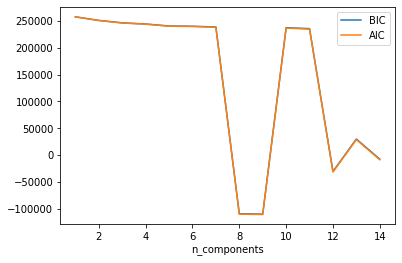

In [40]:
n_components = np.arange(1, 15)
models = [GMM(n, covariance_type='full', random_state=0).fit(data)
          for n in n_components]

plt.plot(n_components, [m.bic(data) for m in models], label='BIC')
plt.plot(n_components, [m.aic(data) for m in models], label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components');

In [84]:
from sklearn.mixture import GaussianMixture as GMM


data_gmm = data.copy()

data_gmm['gmm'] = GMM(n_components=8, random_state=42).fit_predict(data)

In [85]:
fig = px.scatter_3d(data_gmm, x='OccupancyRate', y='Time', z='Day',
              color= 'gmm')
fig.show()

<h1 id="kmeans">
2.4 KMeans
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#kmeans">¶</a>
</h1>

Kmeans algorithm is an iterative algorithm that tries to partition the dataset into K pre-defined distinct non-overlapping subgroups (clusters) where each data point belongs to only one group
It tries to make the intra-cluster data points as similar as possible while also keeping the clusters as different (far) as possible. It assigns data points to a cluster such that the sum of the squared distance between the data points and the cluster’s centroid (arithmetic mean of all the data points that belong to that cluster) is at the minimum. The less variation we have within clusters, the more homogeneous (similar) the data points are within the same cluster.

In [43]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

for n_clusters in range(2,15):
    clusterer = KMeans(n_clusters = n_clusters, n_init=40)
    preds = clusterer.fit_predict(data)
    

    score = silhouette_score (data, preds)
    print ("For n_clusters = {}, silhouette score is {})".format(n_clusters, score))

For n_clusters = 2, silhouette score is 0.29999967789196424)
For n_clusters = 3, silhouette score is 0.2931701063674307)
For n_clusters = 4, silhouette score is 0.29352830045370193)
For n_clusters = 5, silhouette score is 0.3056823984735424)
For n_clusters = 6, silhouette score is 0.30696613227660036)
For n_clusters = 7, silhouette score is 0.312114466954662)
For n_clusters = 8, silhouette score is 0.313891104994771)
For n_clusters = 9, silhouette score is 0.3014973321397176)
For n_clusters = 10, silhouette score is 0.28968673705424597)
For n_clusters = 11, silhouette score is 0.2917132149997269)
For n_clusters = 12, silhouette score is 0.2841065039202821)
For n_clusters = 13, silhouette score is 0.282509708094893)
For n_clusters = 14, silhouette score is 0.2802291273396311)


1 : 91859.45204138129
2 : 61964.508049647266
3 : 46611.34931199999
4 : 37581.77704141326
5 : 30526.658938126024
6 : 26456.308069999784
7 : 23099.835832271587
8 : 20661.796077291416
9 : 19160.359167339328
10 : 17828.494766030468
11 : 16856.550867959224
12 : 15973.73760120819
13 : 15035.730160959143
14 : 14436.409085230049


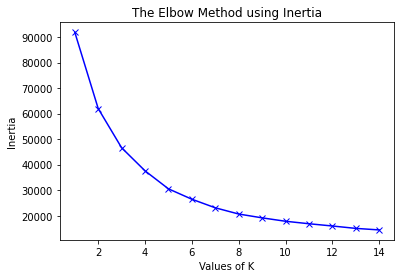

In [44]:
from scipy.spatial.distance import cdist

distortions = [] 
inertias = [] 
mapping1 = {} 
mapping2 = {} 
K = range(1,15) 
  
for k in K: 
    #Building and fitting the model 
    kmeanModel = KMeans(n_clusters=k).fit(data) 
    kmeanModel.fit(data)     
      
    distortions.append(sum(np.min(cdist(data, kmeanModel.cluster_centers_, 
                      'euclidean'),axis=1)) / data.shape[0]) 
    inertias.append(kmeanModel.inertia_) 
  
    mapping1[k] = sum(np.min(cdist(data, kmeanModel.cluster_centers_, 
                 'euclidean'),axis=1)) / data.shape[0] 
    mapping2[k] = kmeanModel.inertia_ 
    
for key,val in mapping2.items(): 
    print(str(key)+' : '+str(val))
    
plt.plot(K, inertias, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Inertia') 
plt.title('The Elbow Method using Inertia') 
plt.show()     

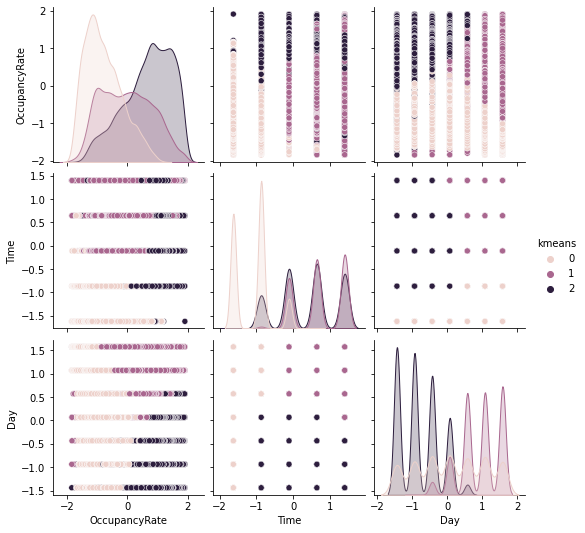

In [45]:
import seaborn as sns

model4 = KMeans(n_clusters = 3, n_init=40)

model4 = model4.fit(data)

data_kmeans = data.copy()

data_kmeans['kmeans'] = model4.fit_predict(data)

sns.pairplot( data_kmeans, hue="kmeans")  

In [46]:
fig = px.scatter_3d(data_kmeans, x='OccupancyRate', y='Time', z='Day',
              color= 'kmeans')
fig.show()

<h1 id="classification">
3 Classification
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#classification">¶</a>
</h1>

<h2 id="Agglomerative_Dataset">
3.1 Agglomerative Dataset
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#Agglomerative_Dataset">¶</a>
</h2>

<h3 id="Decision_Tree">
3.1.1 Decision Tree
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#Decision_Tree">¶</a>
</h3>

In [86]:
data_agg.drop_duplicates()

,OccupancyRate,Time,Day,Agg_Labels
0,-1.446365,-1.625080,-0.938197,0
1,-1.426852,-1.625080,-0.938197,0
2,-1.322786,-1.625080,-0.938197,0
3,-1.147175,-0.867955,-0.938197,0
4,-0.867497,-0.867955,-0.938197,0
...,...,...,...,...
34951,1.122052,0.646294,-1.440596,2
34952,1.063413,1.403418,-1.440596,2
34953,0.955908,1.403418,-1.440596,2
34954,0.738945,1.403418,-1.440596,1


In [87]:
data_agg.describe()

,OccupancyRate,Time,Day,Agg_Labels
count,30953.000000,30953.000000,30953.000000,30953.000000
mean,-0.016325,-0.004991,0.006449,1.053597
std,0.973342,1.009943,1.000212,0.852718
min,-1.843117,-1.625080,-1.440596,0.000000
25%,-0.859861,-0.867955,-0.938197,0.000000
50%,-0.079262,-0.110831,0.066601,1.000000
75%,0.789340,0.646294,1.071400,2.000000
max,1.909766,1.403418,1.573799,2.000000


In [88]:
for col in data_agg.columns:
    print(data_agg[col].value_counts())

 1.909766    20
-1.167598    20
-1.142579    18
 0.408613    18
 1.159189    18
             ..
 0.350235     1
 1.812792     1
 1.078797     1
 1.580329     1
-0.100334     1
Name: OccupancyRate, Length: 14217, dtype: int64
-0.867955    7109
 0.646294    6742
-0.110831    6645
 1.403418    6402
-1.625080    4055
Name: Time, dtype: int64
-0.435798    4723
-0.938197    4720
-1.440596    4715
 0.066601    4387
 0.569001    4262
 1.071400    4098
 1.573799    4048
Name: Day, dtype: int64
2    12127
0    10468
1     8358
Name: Agg_Labels, dtype: int64


In [89]:
X = data_agg.drop(['Agg_Labels'], axis=1)
y = data_agg['Agg_Labels']

In [91]:
fig = px.box(data_agg, y = data_agg.columns )
fig.show()

In [92]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 42, stratify=y)

In [93]:
print(y_test.value_counts()) #we secured the 20% in the classes represenation

2    2425
0    2094
1    1672
Name: Agg_Labels, dtype: int64


In [94]:
from imblearn.over_sampling import SMOTE

sm = SMOTE(random_state = 42)
           
X_train, y_train = sm.fit_sample(X_train, y_train) 

In [95]:
y_train.value_counts()

2    9702
1    9702
0    9702
Name: Agg_Labels, dtype: int64

# GINI CRITERION

In [96]:
from sklearn.metrics import log_loss
from sklearn.tree import DecisionTreeClassifier

training_scores = []
test_scores = []

def tree_scores(i):
    clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=i, random_state = 42)
    
    
    clf_gini.fit(X_train, y_train)
    y_pred_gini = clf_gini.predict_proba(X_test)
    y_pred_train_gini = clf_gini.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))
    training_scores.append(log_loss(y_train, y_pred_train_gini))

    print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))
    test_scores.append(log_loss(y_test, y_pred_gini))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.6308
Test set score: 0.6879
Max Depth: 2
Training set score: 0.8837
Test set score: 0.8806
Max Depth: 3
Training set score: 0.8839
Test set score: 0.8810
Max Depth: 4
Training set score: 0.9181
Test set score: 0.9123
Max Depth: 5
Training set score: 0.9515
Test set score: 0.9541
Max Depth: 6
Training set score: 0.9780
Test set score: 0.9754
Max Depth: 7
Training set score: 0.9872
Test set score: 0.9845
Max Depth: 8
Training set score: 0.9950
Test set score: 0.9940
Max Depth: 9
Training set score: 0.9979
Test set score: 0.9966
Max Depth: 10
Training set score: 0.9994
Test set score: 0.9985


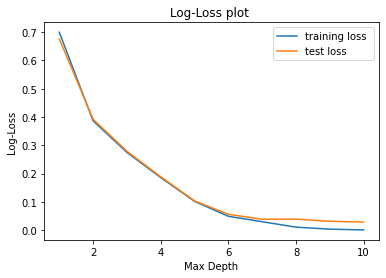

In [97]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_scores, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_scores, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [98]:
from sklearn.model_selection import GridSearchCV

parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='gini', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

0.9979041932953283 {'max_depth': 10}


In [99]:
from sklearn.model_selection import cross_val_score

clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=7, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gini, X_train, y_train, cv=10)))

Cross-Validation Score: 0.9856388199282021


In [100]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=7, random_state = 42)

clf_gini.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=7, random_state=42)

In [101]:
y_pred_gini = clf_gini.predict(X_test)

In [102]:
print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))

Training set score: 0.9872
Test set score: 0.9845


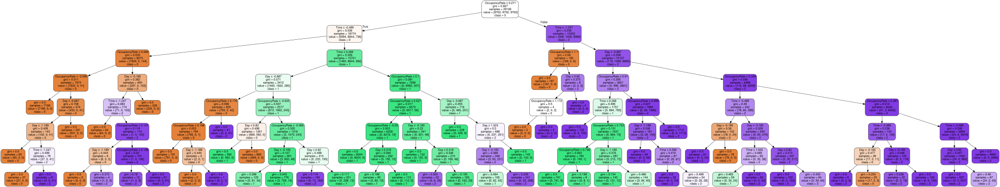

In [103]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import graphviz
from sklearn import tree



dot_data = tree.export_graphviz(clf_gini, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [104]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

cf_matrix = confusion_matrix(y_test, y_pred_gini)

cf_matrix

array([[2083,    1,   10],
       [   0, 1645,   27],
       [   0,   58, 2367]])

[Text(0, 0.5, '2'), Text(0, 1.5, '0'), Text(0, 2.5, '1')]

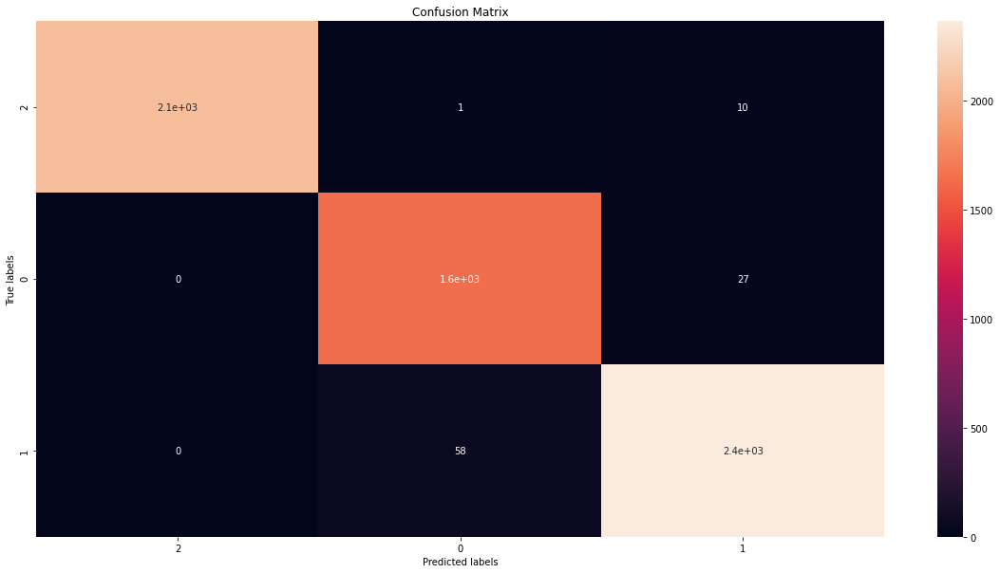

In [105]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [106]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred_gini))

              precision    recall  f1-score   support

           0       1.00      0.99      1.00      2094
           1       0.97      0.98      0.97      1672
           2       0.98      0.98      0.98      2425

    accuracy                           0.98      6191
   macro avg       0.98      0.98      0.98      6191
weighted avg       0.98      0.98      0.98      6191



In [107]:
import dataframe_image as dfi

report = classification_report(y_test, y_pred_gini, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'agg_decision_tree_gini.png')

# ENTROPY CRITERION

In [108]:
training_scores = []
test_scores = []

def tree_scores(i):
    clf_gini = DecisionTreeClassifier(criterion='entropy', max_depth=i, random_state = 42)
    
    
    clf_gini.fit(X_train, y_train)
    y_pred_gini = clf_gini.predict_proba(X_test)
    y_pred_train_gini = clf_gini.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))
    training_scores.append(log_loss(y_train, y_pred_train_gini))

    print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))
    test_scores.append(log_loss(y_test, y_pred_gini))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.6371
Test set score: 0.6997
Max Depth: 2
Training set score: 0.8684
Test set score: 0.8724
Max Depth: 3
Training set score: 0.8684
Test set score: 0.8724
Max Depth: 4
Training set score: 0.9283
Test set score: 0.9304
Max Depth: 5
Training set score: 0.9468
Test set score: 0.9517
Max Depth: 6
Training set score: 0.9847
Test set score: 0.9858
Max Depth: 7
Training set score: 0.9875
Test set score: 0.9868
Max Depth: 8
Training set score: 0.9935
Test set score: 0.9921
Max Depth: 9
Training set score: 0.9970
Test set score: 0.9950
Max Depth: 10
Training set score: 0.9978
Test set score: 0.9966


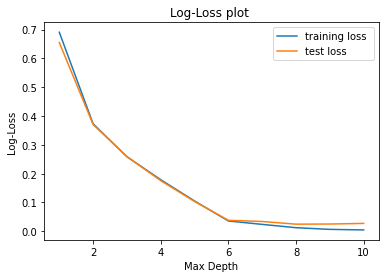

In [109]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_scores, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_scores, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [110]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='entropy', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

0.9972514022039982 {'max_depth': 10}


In [111]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=6, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_en, X_train, y_train, cv=10)))

Cross-Validation Score: 0.9839894298318619


In [112]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=6, random_state = 42)

clf_en.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=6, random_state=42)

In [113]:
y_pred_en = clf_gini.predict(X_test)

In [114]:
print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))

Training set score: 0.9847
Test set score: 0.9858


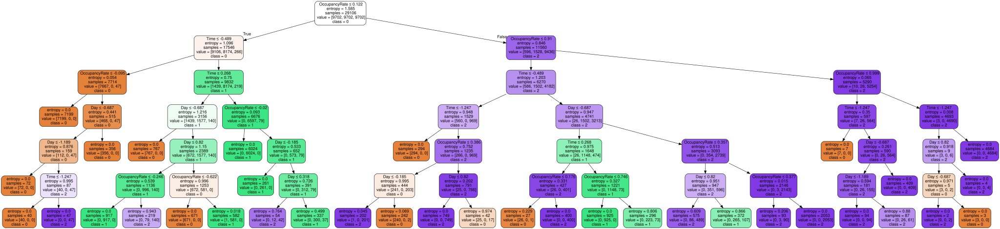

In [115]:

dot_data = tree.export_graphviz(clf_en, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [117]:
cf_matrix = confusion_matrix(y_test, y_pred_en)

cf_matrix

array([[2083,    1,   10],
       [   0, 1645,   27],
       [   0,   58, 2367]])

[Text(0, 0.5, '2'), Text(0, 1.5, '0'), Text(0, 2.5, '1')]

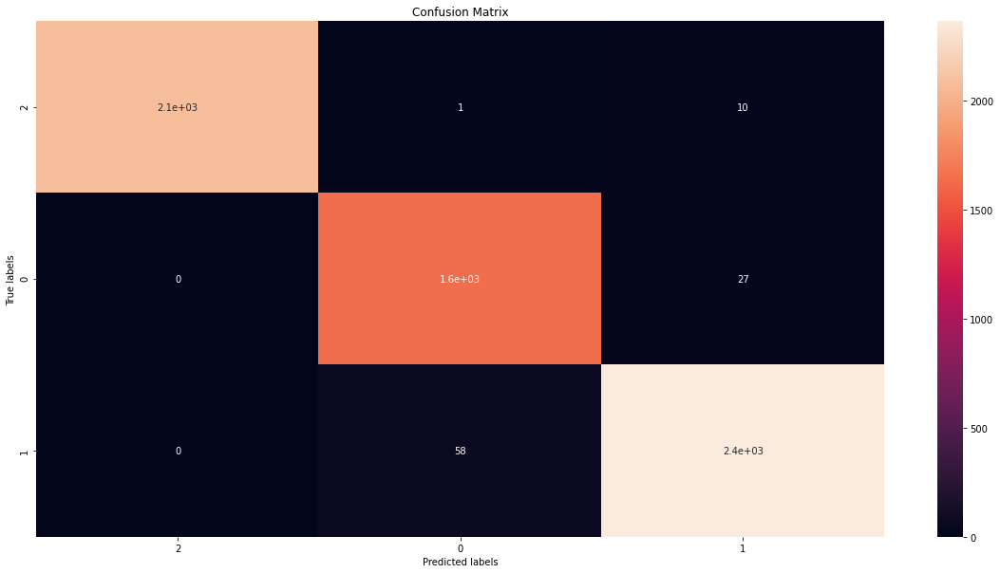

In [118]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [119]:
print(classification_report(y_test, y_pred_en))

              precision    recall  f1-score   support

           0       1.00      0.99      1.00      2094
           1       0.97      0.98      0.97      1672
           2       0.98      0.98      0.98      2425

    accuracy                           0.98      6191
   macro avg       0.98      0.98      0.98      6191
weighted avg       0.98      0.98      0.98      6191



In [120]:
import dataframe_image as dfi

report = classification_report(y_test, y_pred_en, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'agg_decision_tree_entropy.png')

# GRADIENT BOOSTING

In [122]:
from sklearn.ensemble import GradientBoostingClassifier

training_loss = []
test_loss = []

def tree_scores(i):
    clf_gb = GradientBoostingClassifier( max_depth=i, random_state = 42)
    
    
    clf_gb.fit(X_train, y_train.values.ravel())
    y_pred_gb = clf_gb.predict_proba(X_test)
    y_pred_train_gb = clf_gb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_gb))

    print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_gb))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.9213
Test set score: 0.9257
Max Depth: 2
Training set score: 0.9786
Test set score: 0.9777
Max Depth: 3
Training set score: 0.9917
Test set score: 0.9897
Max Depth: 4
Training set score: 0.9990
Test set score: 0.9974
Max Depth: 5
Training set score: 1.0000
Test set score: 0.9992
Max Depth: 6
Training set score: 1.0000
Test set score: 0.9994
Max Depth: 7
Training set score: 1.0000
Test set score: 0.9995
Max Depth: 8
Training set score: 1.0000
Test set score: 0.9994
Max Depth: 9
Training set score: 1.0000
Test set score: 0.9994
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9992


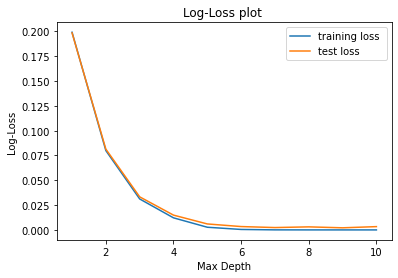

In [123]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [124]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(GradientBoostingClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/joblib/externals/loky/process_executor.py:688: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.



KeyboardInterrupt: 

In [91]:
clf_gb = GradientBoostingClassifier( max_depth=3, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gb, X_train, y_train.values.ravel(), cv=10)))

Cross-Validation Score: 0.982192384769539


In [125]:
clf_gb = GradientBoostingClassifier( max_depth=6, random_state = 42)

clf_gb.fit(X_train, y_train.values.ravel())

GradientBoostingClassifier(max_depth=6, random_state=42)

In [126]:
y_pred_gb = clf_gb.predict(X_test)

In [127]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 0.9994


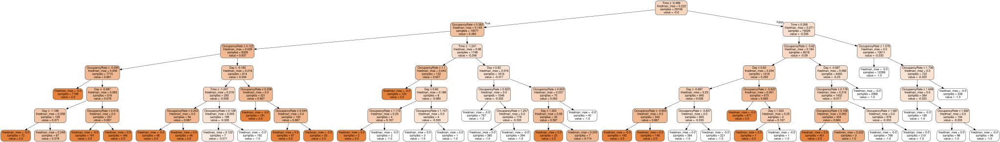

In [128]:
dot_data = tree.export_graphviz(clf_gb.estimators_[0, 0], out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [129]:
cm = confusion_matrix(y_test, y_pred_gb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[2094    0    0]
 [   0 1671    1]
 [   1    2 2422]]


[Text(0, 0.5, '2'), Text(0, 1.5, '0'), Text(0, 2.5, '1')]

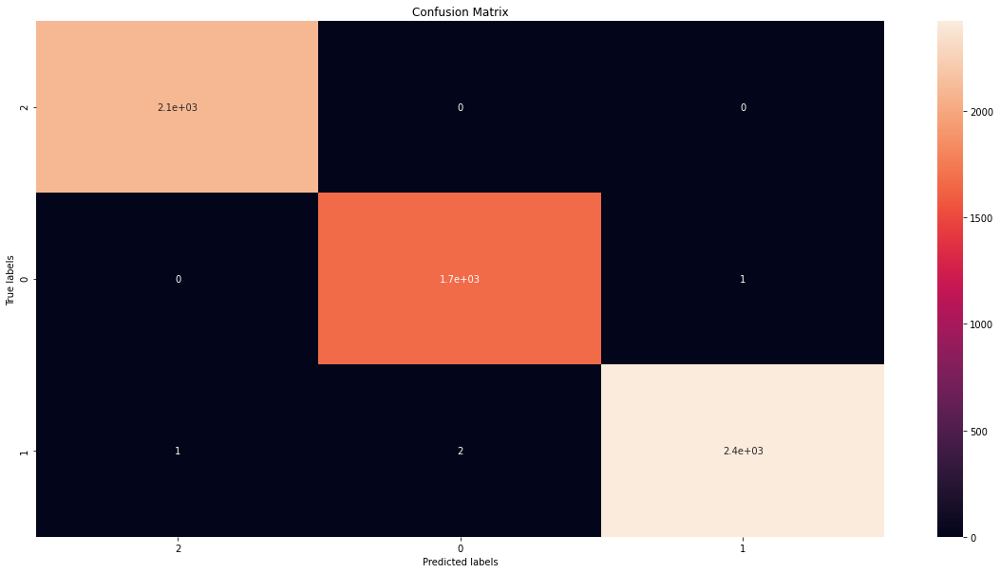

In [130]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [131]:
print(classification_report(y_test, y_pred_gb))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2094
           1       1.00      1.00      1.00      1672
           2       1.00      1.00      1.00      2425

    accuracy                           1.00      6191
   macro avg       1.00      1.00      1.00      6191
weighted avg       1.00      1.00      1.00      6191



In [132]:
report = classification_report(y_test, y_pred_gb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'agg_gradient_boosting.png')

# XGBOOST

In [133]:
import xgboost as xgb

training_loss = []
test_loss = []

def tree_scores(i):
    clf_xgb = xgb.XGBClassifier( max_depth=i, random_state = 42, n_jobs = 4, verbose = 0)
    
    
    clf_xgb.fit(X_train, y_train.values.ravel())
    y_pred_xgb = clf_xgb.predict_proba(X_test)
    y_pred_train_xgb = clf_xgb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_xgb))

    print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_xgb))
     
        
for i in range(1,11):
    tree_scores(i)

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[23:39:30] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[23:39:30] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 1
Training set score: 0.9505
Test set score: 0.9496
[23:39:31] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[23:39:31] WARN

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 2
Training set score: 0.9892
Test set score: 0.9866
[23:39:33] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[23:39:33] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 3
Training set score: 0.9985
Test set score: 0.9968
[23:39:38] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.




/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[23:39:38] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 4
Training set score: 1.0000
Test set score: 0.9992
[23:39:42] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[23:39:42] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 5
Training set score: 1.0000
Test set score: 0.9995
[23:39:47] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[23:39:47] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 6
Training set score: 1.0000
Test set score: 0.9995
[23:39:52] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.




/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[23:39:52] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 7
Training set score: 1.0000
Test set score: 0.9997
[23:39:59] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[23:39:59] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 8
Training set score: 1.0000
Test set score: 0.9997
[23:40:04] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.




/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[23:40:04] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 9
Training set score: 1.0000
Test set score: 0.9995
[23:40:11] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.




/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[23:40:11] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9995


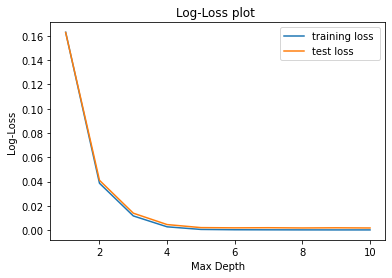

In [134]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [135]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(xgb.XGBClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[23:42:40] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
0.9991410705655868 {'max_depth': 9}


In [136]:
clf_xgb = xgb.XGBClassifier( max_depth=5, random_state = 42, n_jobs = 4)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_xgb, X_train, y_train.values.ravel(), cv=10)))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[23:43:00] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:43:05] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:43:09] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:43:12] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd li

In [137]:
clf_xgb = xgb.XGBClassifier( max_depth=5, random_state = 42, n_jobs = 4)

clf_xgb.fit(X_train, y_train.values.ravel())

[23:43:45] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=42, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [138]:
y_pred_xgb = clf_xgb.predict(X_test)

In [139]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 0.9995


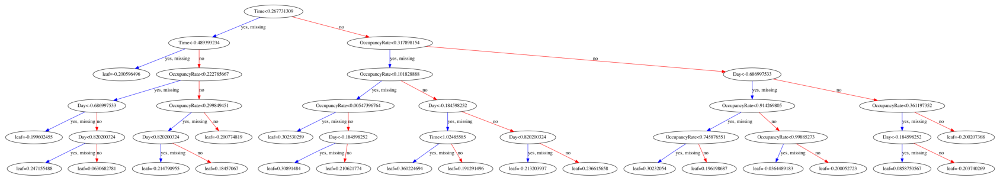

In [140]:
fig, ax = plt.subplots(figsize=(30, 30))
xgb.plot_tree(clf_xgb, num_trees=4, ax=ax)
plt.show()

In [141]:
cm = confusion_matrix(y_test, y_pred_xgb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[2094    0    0]
 [   0 1672    0]
 [   1    2 2422]]


[Text(0, 0.5, '2'), Text(0, 1.5, '0'), Text(0, 2.5, '1')]

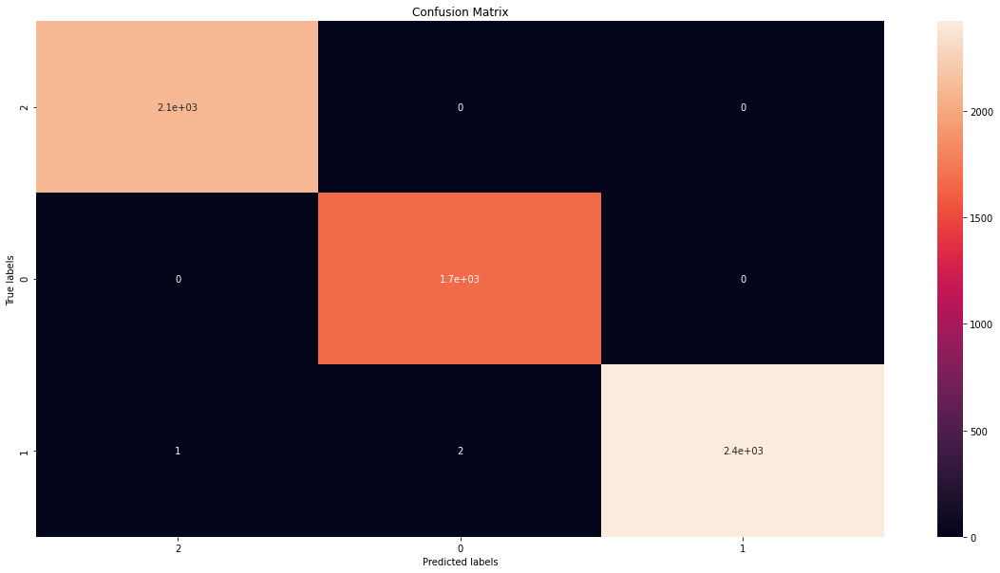

In [142]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [143]:
print(classification_report(y_test, y_pred_xgb))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2094
           1       1.00      1.00      1.00      1672
           2       1.00      1.00      1.00      2425

    accuracy                           1.00      6191
   macro avg       1.00      1.00      1.00      6191
weighted avg       1.00      1.00      1.00      6191



In [144]:
report = classification_report(y_test, y_pred_xgb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'agg_xgb.png')

<h3 id="DBSCAN_Dataset">
3.2 DBSCAN Dataset
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#DBSCAN_Dataset">¶</a>
</h3>

### 3.2.1 Decision Tree

In [145]:
data_DB_filtered.describe()

,OccupancyRate,Time,Day,DB_Labels
count,319.000000,319.000000,319.000000,319.000000
mean,-1.202157,-0.782512,1.487179,1.228840
std,0.103038,0.239940,0.190074,1.269248
min,-1.371087,-0.867955,1.071400,0.000000
25%,-1.292164,-0.867955,1.573799,0.000000
50%,-1.205127,-0.867955,1.573799,1.000000
75%,-1.132994,-0.867955,1.573799,3.000000
max,-0.992463,-0.110831,1.573799,3.000000


In [146]:
data_DB_filtered.drop_duplicates()

,OccupancyRate,Time,Day,DB_Labels
97,-1.023596,-0.110831,1.573799,1
312,-1.322786,-0.867955,1.573799,0
314,-1.030100,-0.110831,1.573799,1
435,-1.296770,-0.867955,1.573799,0
559,-1.342299,-0.867955,1.573799,0
...,...,...,...,...
34458,-1.256729,-0.867955,1.573799,0
34460,-1.143360,-0.867955,1.573799,3
34462,-1.022174,-0.110831,1.573799,1
34582,-1.205908,-0.867955,1.573799,3


In [147]:
for col in data_DB_filtered.columns:
    print(data_DB_filtered[col].value_counts())

-1.142579    2
-1.097360    1
-1.141491    1
-1.023596    1
-1.355242    1
            ..
-1.355764    1
-1.030100    1
-1.292694    1
-1.291912    1
-1.308131    1
Name: OccupancyRate, Length: 318, dtype: int64
-0.867955    283
-0.110831     36
Name: Time, dtype: int64
1.573799    264
1.071400     55
Name: Day, dtype: int64
0    146
3     82
2     55
1     36
Name: DB_Labels, dtype: int64


In [148]:
X = data_DB_filtered.drop(['DB_Labels'], axis = 1)
y = data_DB_filtered['DB_Labels']

In [149]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 42, stratify=y)

In [150]:
print(y_test.value_counts()) #we secured the 20% in the classes represenation

0    29
3    17
2    11
1     7
Name: DB_Labels, dtype: int64


In [280]:
sm = SMOTE(random_state = 42)
           
X_train, y_train = sm.fit_sample(X_train, y_train) 

In [281]:
print(y_train.value_counts())

3    2611
2    2611
1    2611
0    2611
Name: DBLabels, dtype: int64


# GINI CRITERION

In [151]:
training_scores = []
test_scores = []

def tree_scores(i):
    clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=i, random_state = 42)
    
    
    clf_gini.fit(X_train, y_train)
    y_pred_gini = clf_gini.predict_proba(X_test)
    y_pred_train_gini = clf_gini.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))
    training_scores.append(log_loss(y_train, y_pred_train_gini))

    print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))
    test_scores.append(log_loss(y_test, y_pred_gini))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.7137
Test set score: 0.7188
Max Depth: 2
Training set score: 0.8863
Test set score: 0.8906
Max Depth: 3
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 4
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 5
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 6
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 7
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 8
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 9
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 10
Training set score: 1.0000
Test set score: 1.0000


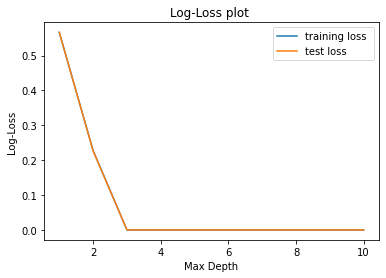

In [152]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_scores, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_scores, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [153]:
from sklearn.model_selection import GridSearchCV

parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='gini', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

1.0 {'max_depth': 3}


In [154]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=3, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gini, X_train, y_train, cv=10)))

Cross-Validation Score: 1.0


In [155]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=, random_state = 42)

clf_gini.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=3, random_state=42)

In [156]:
y_pred_gini = clf_gini.predict(X_test)

In [157]:
print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 1.0000


In [160]:
dot_data = tree.export_graphviz(clf_gini, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

KeyError: 0

In [161]:
cf_matrix = confusion_matrix(y_test, y_pred_gini)

cf_matrix

array([[29,  0,  0,  0],
       [ 0,  7,  0,  0],
       [ 0,  0, 11,  0],
       [ 0,  0,  0, 17]])

[Text(0, 0.5, '3'), Text(0, 1.5, '2'), Text(0, 2.5, '0'), Text(0, 3.5, '1')]

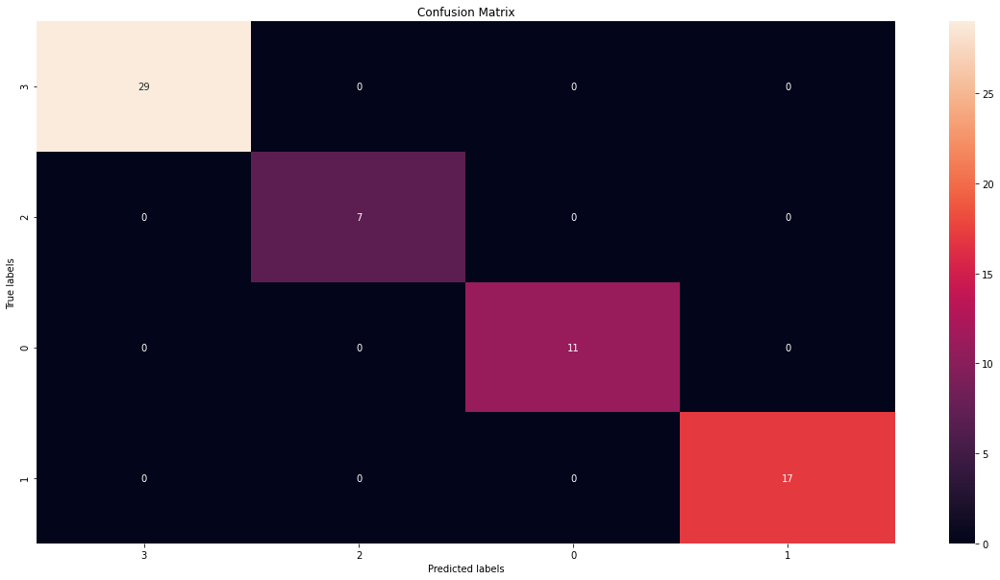

In [162]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [163]:
print(classification_report(y_test, y_pred_gini))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        29
           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00        11
           3       1.00      1.00      1.00        17

    accuracy                           1.00        64
   macro avg       1.00      1.00      1.00        64
weighted avg       1.00      1.00      1.00        64



In [164]:
report = classification_report(y_test, y_pred_gini, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'db_gini.png')

# ENTROPY CRITERION

In [165]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=i, random_state = 42)
    
    
    clf_en.fit(X_train, y_train)
    y_pred_en = clf_en.predict_proba(X_test)
    y_pred_train_en = clf_en.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_en))

    print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_en))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.7137
Test set score: 0.7188
Max Depth: 2
Training set score: 0.8863
Test set score: 0.8906
Max Depth: 3
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 4
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 5
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 6
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 7
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 8
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 9
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 10
Training set score: 1.0000
Test set score: 1.0000


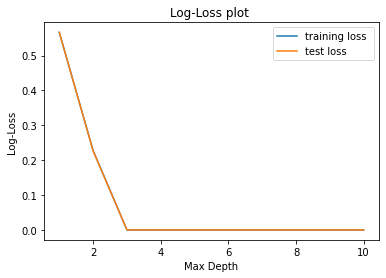

In [166]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [167]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='entropy', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

1.0 {'max_depth': 3}


In [168]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=3, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_en, X_train, y_train, cv=10)))

Cross-Validation Score: 1.0


In [169]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=3, random_state = 42)

clf_en.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=3, random_state=42)

In [170]:
y_pred_en = clf_en.predict(X_test)

In [171]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 1.0000


In [172]:
dot_data = tree.export_graphviz(clf_en, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

KeyError: 0

In [173]:
cm = confusion_matrix(y_test, y_pred_en)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[29  0  0  0]
 [ 0  7  0  0]
 [ 0  0 11  0]
 [ 0  0  0 17]]


[Text(0, 0.5, '3'), Text(0, 1.5, '2'), Text(0, 2.5, '0'), Text(0, 3.5, '1')]

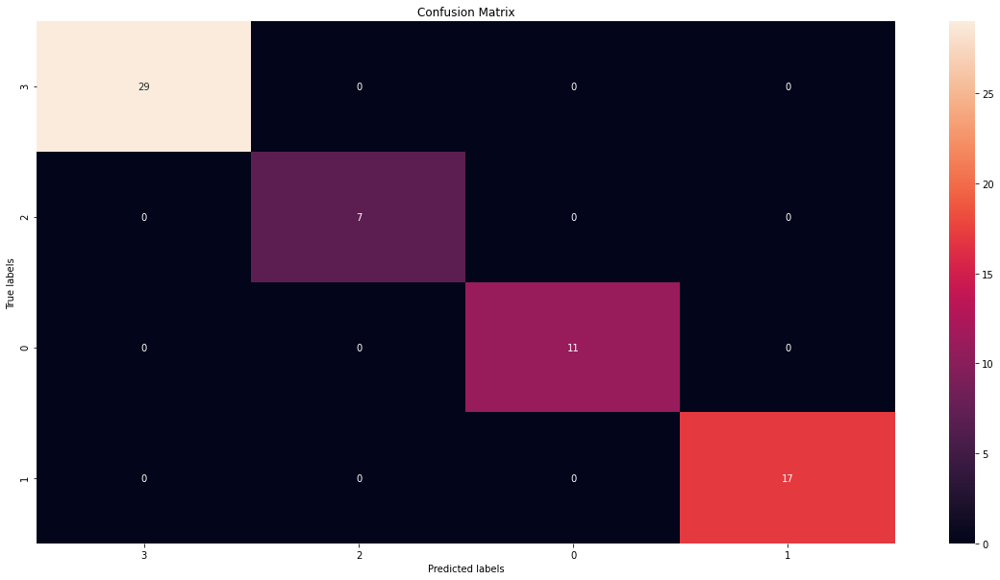

In [174]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [175]:
print(classification_report(y_test, y_pred_en))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        29
           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00        11
           3       1.00      1.00      1.00        17

    accuracy                           1.00        64
   macro avg       1.00      1.00      1.00        64
weighted avg       1.00      1.00      1.00        64



In [176]:
report = classification_report(y_test, y_pred_en, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'db_entropy.png')

# GRADIENT BOOSTING

In [177]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_gb = GradientBoostingClassifier( max_depth=i, random_state = 42)
    
    
    clf_gb.fit(X_train, y_train.values.ravel())
    y_pred_gb = clf_gb.predict_proba(X_test)
    y_pred_train_gb = clf_gb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_gb))

    print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_gb))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 2
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 3
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 4
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 5
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 6
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 7
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 8
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 9
Training set score: 1.0000
Test set score: 1.0000
Max Depth: 10
Training set score: 1.0000
Test set score: 1.0000


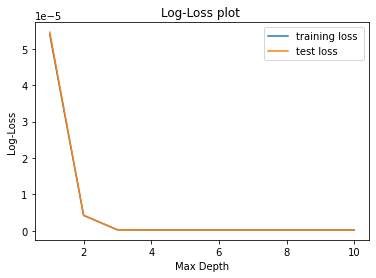

In [178]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [179]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(GradientBoostingClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

1.0 {'max_depth': 1}


In [180]:
clf_gb = GradientBoostingClassifier( max_depth=3, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gb, X_train, y_train.values.ravel(), cv=10)))

Cross-Validation Score: 0.9961538461538462


In [181]:
clf_gb = GradientBoostingClassifier( max_depth=3, random_state = 42)

clf_gb.fit(X_train, y_train.values.ravel())

GradientBoostingClassifier(random_state=42)

In [182]:
y_pred_gb = clf_gb.predict(X_test)

In [183]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 1.0000


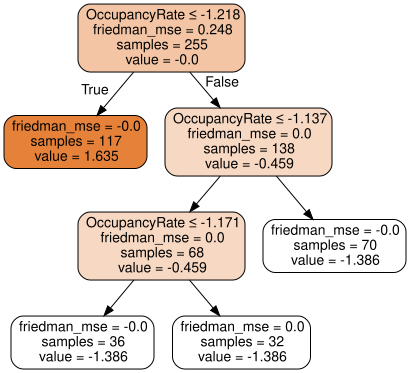

In [184]:
dot_data = tree.export_graphviz(clf_gb.estimators_[0, 0], out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [185]:
cm = confusion_matrix(y_test, y_pred_gb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[29  0  0  0]
 [ 0  7  0  0]
 [ 0  0 11  0]
 [ 0  0  0 17]]


[Text(0, 0.5, '3'), Text(0, 1.5, '2'), Text(0, 2.5, '0'), Text(0, 3.5, '1')]

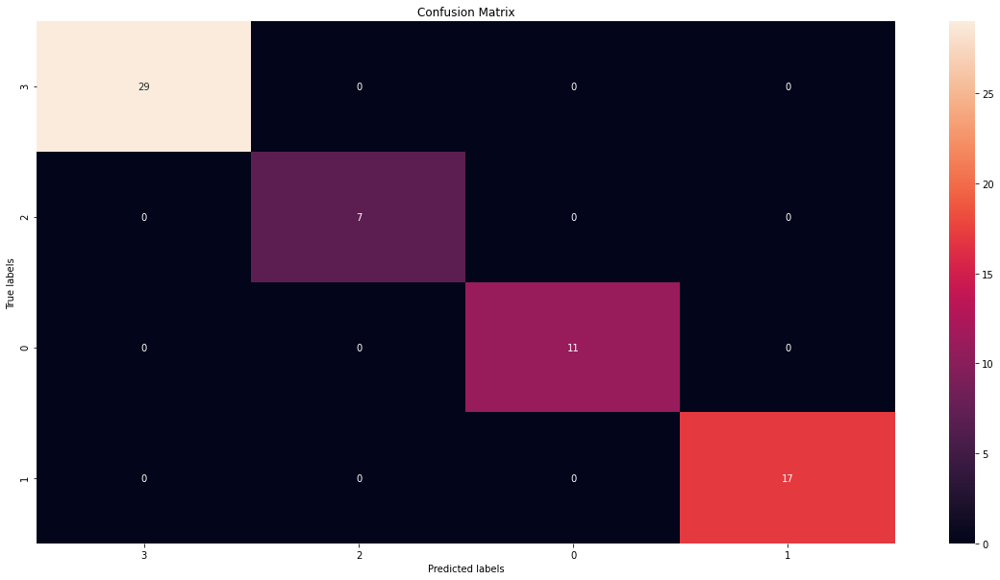

In [186]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [187]:
print(classification_report(y_test, y_pred_gb))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        29
           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00        11
           3       1.00      1.00      1.00        17

    accuracy                           1.00        64
   macro avg       1.00      1.00      1.00        64
weighted avg       1.00      1.00      1.00        64



In [188]:
report = classification_report(y_test, y_pred_gb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'db_gb.png')

# XGBOOST

In [189]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_xgb = xgb.XGBClassifier( max_depth=i, random_state = 42, n_jobs = 4)
    
    
    clf_xgb.fit(X_train, y_train.values.ravel())
    y_pred_xgb = clf_xgb.predict_proba(X_test)
    y_pred_train_xgb = clf_xgb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_xgb))

    print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_xgb))
     
        
for i in range(1,11):
    tree_scores(i)

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[00:13:09] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 1
Training set score: 1.0000
Test set score: 1.0000
[00:13:09] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 2
Training set score: 1.0000
Test set score: 1.0000
[00:13:09] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 3
Training set score: 1.0000
Test set score: 1.0000
[00:13:09] WARNING: xgboost/src/learn

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder

Training set score: 1.0000
Test set score: 1.0000
[00:13:09] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 5
Training set score: 1.0000
Test set score: 1.0000
[00:13:09] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 6
Training set score: 1.0000
Test set score: 1.0000
[00:13:10] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 7
Training set score: 1.0000
Test set score: 1.0000
[00:13:10] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 8
Training set score: 1.0000
Test set score: 1.0000
[00:13:10] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 9
Training set score: 1.0000
Test set score: 1.0000
[00:13:10] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 10
Training set score: 1.0000
Test set score: 1.0000


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



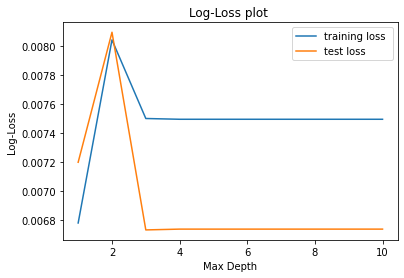

In [190]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [191]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(xgb.XGBClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

[00:13:50] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
1.0 {'max_depth': 1}


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



In [193]:
clf_xgb = xgb.XGBClassifier( max_depth=2, random_state = 42, n_jobs = 4)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_xgb, X_train, y_train.values.ravel(), cv=10)))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[00:14:22] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:14:22] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:14:22] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:14:22] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd li

In [194]:
clf_xgb = xgb.XGBClassifier( max_depth=2, random_state = 42, n_jobs = 4)

clf_xgb.fit(X_train, y_train.values.ravel())

[00:14:28] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=2,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=42, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [195]:
y_pred_xgb = clf_xgb.predict(X_test)

In [196]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 1.0000


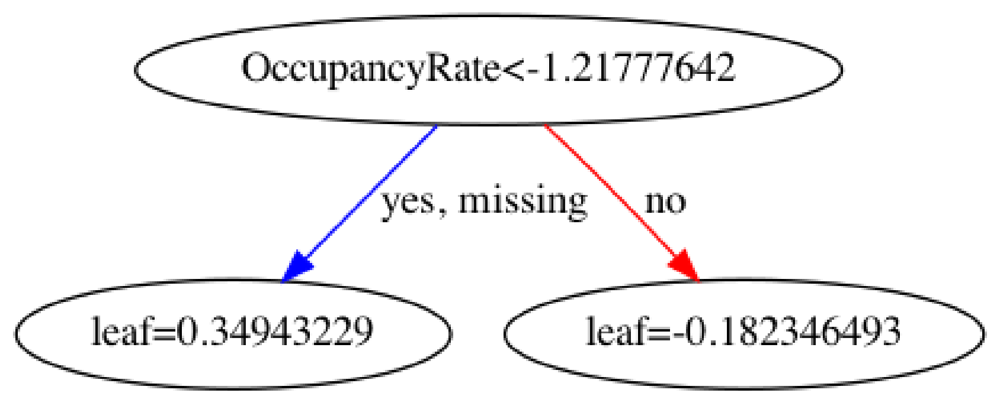

In [197]:
fig, ax = plt.subplots(figsize=(30, 30))
xgb.plot_tree(clf_xgb, num_trees=4, ax=ax)
plt.show()

In [198]:
cm = confusion_matrix(y_test, y_pred_xgb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[29  0  0  0]
 [ 0  7  0  0]
 [ 0  0 11  0]
 [ 0  0  0 17]]


[Text(0, 0.5, '3'), Text(0, 1.5, '2'), Text(0, 2.5, '0'), Text(0, 3.5, '1')]

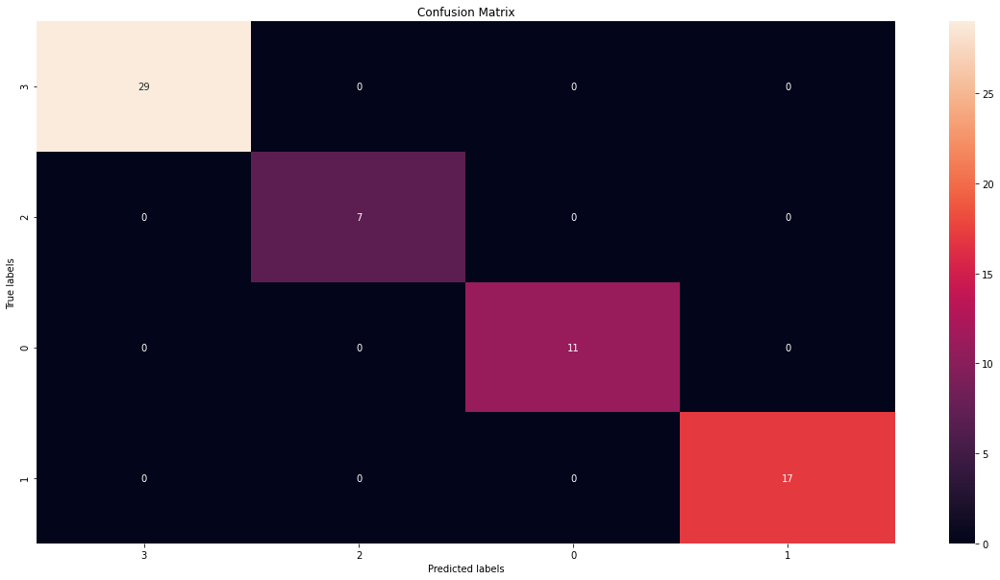

In [199]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [200]:
print(classification_report(y_test, y_pred_xgb))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        29
           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00        11
           3       1.00      1.00      1.00        17

    accuracy                           1.00        64
   macro avg       1.00      1.00      1.00        64
weighted avg       1.00      1.00      1.00        64



In [201]:
report = classification_report(y_test, y_pred_xgb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'db_xgb.png')

<h3 id="EM-GMM_Dataset">
3.3 EM-GMM Dataset
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#EM-GMM_Dataset">¶</a>
</h3>

### 3.3.1 Decision Tree

In [202]:
data_gmm.describe()

,OccupancyRate,Time,Day,gmm
count,30953.000000,30953.000000,30953.000000,30953.000000
mean,-0.016325,-0.004991,0.006449,3.461958
std,0.973342,1.009943,1.000212,2.311891
min,-1.843117,-1.625080,-1.440596,0.000000
25%,-0.859861,-0.867955,-0.938197,1.000000
50%,-0.079262,-0.110831,0.066601,4.000000
75%,0.789340,0.646294,1.071400,5.000000
max,1.909766,1.403418,1.573799,7.000000


In [203]:
data_gmm.drop_duplicates()

,OccupancyRate,Time,Day,gmm
0,-1.446365,-1.625080,-0.938197,1
1,-1.426852,-1.625080,-0.938197,1
2,-1.322786,-1.625080,-0.938197,1
3,-1.147175,-0.867955,-0.938197,1
4,-0.867497,-0.867955,-0.938197,1
...,...,...,...,...
34951,1.122052,0.646294,-1.440596,0
34952,1.063413,1.403418,-1.440596,0
34953,0.955908,1.403418,-1.440596,0
34954,0.738945,1.403418,-1.440596,0


In [204]:
for col in data_gmm.columns:
    print(data_gmm[col].value_counts())

 1.909766    20
-1.167598    20
-1.142579    18
 0.408613    18
 1.159189    18
             ..
 0.350235     1
 1.812792     1
 1.078797     1
 1.580329     1
-0.100334     1
Name: OccupancyRate, Length: 14217, dtype: int64
-0.867955    7109
 0.646294    6742
-0.110831    6645
 1.403418    6402
-1.625080    4055
Name: Time, dtype: int64
-0.435798    4723
-0.938197    4720
-1.440596    4715
 0.066601    4387
 0.569001    4262
 1.071400    4098
 1.573799    4048
Name: Day, dtype: int64
1    4749
4    4119
5    4053
0    3968
7    3892
3    3868
6    3553
2    2751
Name: gmm, dtype: int64


In [205]:
X = data_gmm.drop(['gmm'], axis = 1)
y = data_gmm['gmm']

In [206]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 42, stratify=y)

In [207]:
print(y_test.value_counts()) #we secured the 20% in the classes represenation

1    950
4    824
5    811
0    794
7    778
3    774
6    710
2    550
Name: gmm, dtype: int64


In [208]:
sm = SMOTE(random_state = 42)
           
X_train, y_train = sm.fit_sample(X_train, y_train) 

In [209]:
print(y_train.value_counts())

7    3799
6    3799
5    3799
4    3799
3    3799
2    3799
1    3799
0    3799
Name: gmm, dtype: int64


# GINI CRITERION

In [210]:
training_scores = []
test_scores = []

def tree_scores(i):
    clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=i, random_state = 42)
    
    
    clf_gini.fit(X_train, y_train)
    y_pred_gini = clf_gini.predict_proba(X_test)
    y_pred_train_gini = clf_gini.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))
    training_scores.append(log_loss(y_train, y_pred_train_gini))

    print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))
    test_scores.append(log_loss(y_test, y_pred_gini))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.2500
Test set score: 0.2817
Max Depth: 2
Training set score: 0.4999
Test set score: 0.4752
Max Depth: 3
Training set score: 0.8652
Test set score: 0.8572
Max Depth: 4
Training set score: 0.9299
Test set score: 0.9275
Max Depth: 5
Training set score: 0.9655
Test set score: 0.9606
Max Depth: 6
Training set score: 0.9803
Test set score: 0.9771
Max Depth: 7
Training set score: 0.9916
Test set score: 0.9892
Max Depth: 8
Training set score: 0.9964
Test set score: 0.9940
Max Depth: 9
Training set score: 0.9987
Test set score: 0.9964
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9974


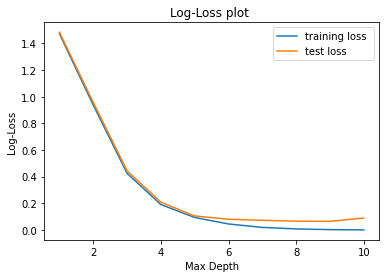

In [211]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_scores, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_scores, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [212]:
from sklearn.model_selection import GridSearchCV

parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='gini', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

0.9978283953610466 {'max_depth': 10}


In [213]:
from sklearn.model_selection import cross_val_score

clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=5, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gini, X_train, y_train, cv=10)))

Cross-Validation Score: 0.964497248488942


In [214]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=5, random_state = 42)

clf_gini.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=5, random_state=42)

In [215]:
y_pred_gini = clf_gini.predict(X_test)

In [216]:
print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))

Training set score: 0.9655
Test set score: 0.9606


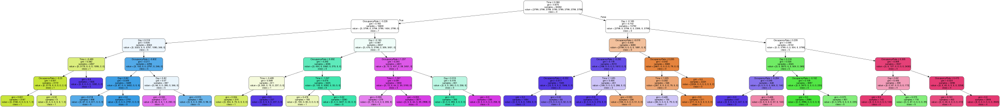

In [217]:
dot_data = tree.export_graphviz(clf_gini, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [218]:

cf_matrix = confusion_matrix(y_test, y_pred_gini)

cf_matrix

array([[779,   0,   0,   0,   0,  15,   0,   0],
       [  0, 896,   0,   0,  24,   0,  30,   0],
       [  0,   0, 546,   0,   0,   0,   0,   4],
       [  0,  30,   0, 739,   0,   0,   5,   0],
       [  0,   0,   0,   0, 824,   0,   0,   0],
       [ 14,   0,   0,   8,   0, 760,  11,  18],
       [  0,   0,   0,   0,  24,   0, 686,   0],
       [  0,   0,  61,   0,   0,   0,   0, 717]])

[Text(0, 0.5, '3'),
 Text(0, 1.5, '5'),
 Text(0, 2.5, '6'),
 Text(0, 3.5, '0'),
 Text(0, 4.5, '1'),
 Text(0, 5.5, '4'),
 Text(0, 6.5, '7'),
 Text(0, 7.5, '2')]

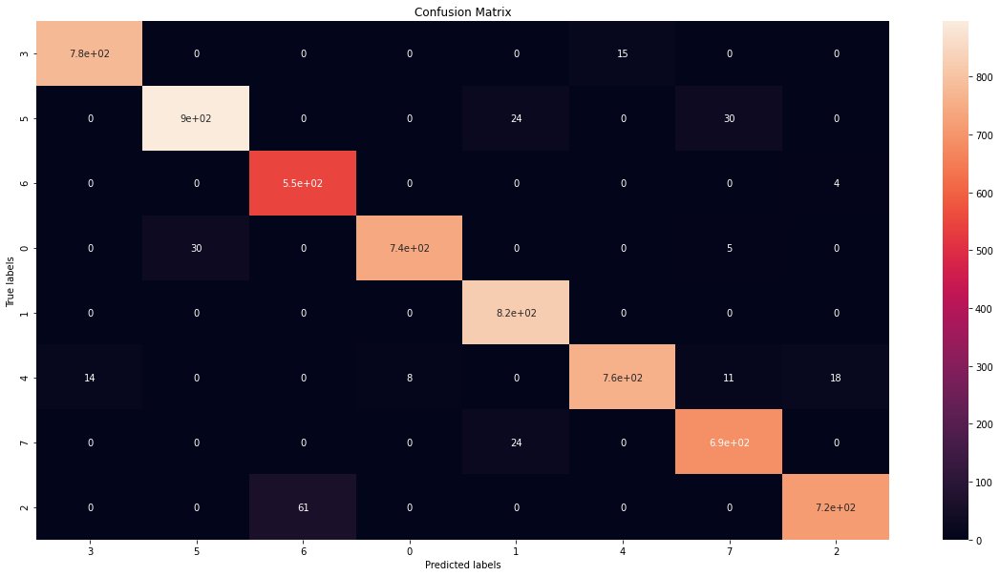

In [219]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [220]:
print(classification_report(y_test, y_pred_gini))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98       794
           1       0.97      0.94      0.96       950
           2       0.90      0.99      0.94       550
           3       0.99      0.95      0.97       774
           4       0.94      1.00      0.97       824
           5       0.98      0.94      0.96       811
           6       0.94      0.97      0.95       710
           7       0.97      0.92      0.95       778

    accuracy                           0.96      6191
   macro avg       0.96      0.96      0.96      6191
weighted avg       0.96      0.96      0.96      6191



In [221]:
report = classification_report(y_test, y_pred_gini, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'gmm_gini.png')

# ENTROPY

In [222]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=i, random_state = 42)
    
    
    clf_en.fit(X_train, y_train)
    y_pred_en = clf_en.predict_proba(X_test)
    y_pred_train_en = clf_en.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_en))

    print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_en))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.2500
Test set score: 0.2817
Max Depth: 2
Training set score: 0.5000
Test set score: 0.4752
Max Depth: 3
Training set score: 0.8608
Test set score: 0.8548
Max Depth: 4
Training set score: 0.9344
Test set score: 0.9325
Max Depth: 5
Training set score: 0.9658
Test set score: 0.9611
Max Depth: 6
Training set score: 0.9827
Test set score: 0.9788
Max Depth: 7
Training set score: 0.9922
Test set score: 0.9906
Max Depth: 8
Training set score: 0.9973
Test set score: 0.9950
Max Depth: 9
Training set score: 0.9989
Test set score: 0.9976
Max Depth: 10
Training set score: 0.9994
Test set score: 0.9973


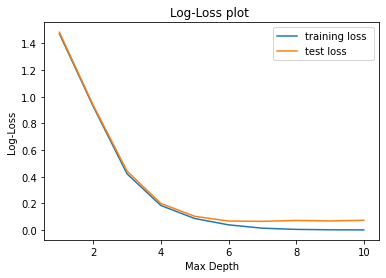

In [223]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [224]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='entropy', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

0.9979600176052059 {'max_depth': 10}


In [225]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=5, random_state = 42)

clf_en.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=5, random_state=42)

In [226]:
y_pred_en = clf_en.predict(X_test)

In [227]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))

Training set score: 0.9658
Test set score: 0.9611


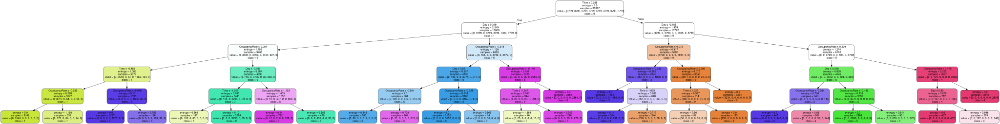

In [228]:
dot_data = tree.export_graphviz(clf_en, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [229]:
cm = confusion_matrix(y_test, y_pred_en)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[794   0   0   0   0   0   0   0]
 [  0 909   0   0  24   0  17   0]
 [  0   0 531   0   0   0   0  19]
 [  0  28   0 746   0   0   0   0]
 [  0   2   0   0 810   0  12   0]
 [ 23   0   0  11   0 759   0  18]
 [  0  20   0   6   0   6 678   0]
 [  0   0  55   0   0   0   0 723]]


[Text(0, 0.5, '3'),
 Text(0, 1.5, '5'),
 Text(0, 2.5, '6'),
 Text(0, 3.5, '0'),
 Text(0, 4.5, '1'),
 Text(0, 5.5, '4'),
 Text(0, 6.5, '7'),
 Text(0, 7.5, '2')]

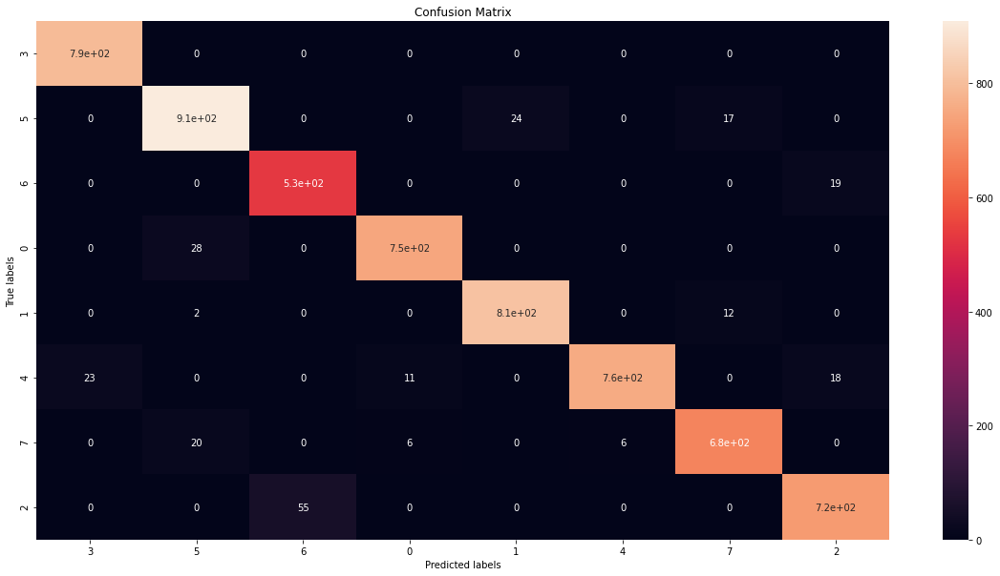

In [230]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [231]:
print(classification_report(y_test, y_pred_en))

              precision    recall  f1-score   support

           0       0.97      1.00      0.99       794
           1       0.95      0.96      0.95       950
           2       0.91      0.97      0.93       550
           3       0.98      0.96      0.97       774
           4       0.97      0.98      0.98       824
           5       0.99      0.94      0.96       811
           6       0.96      0.95      0.96       710
           7       0.95      0.93      0.94       778

    accuracy                           0.96      6191
   macro avg       0.96      0.96      0.96      6191
weighted avg       0.96      0.96      0.96      6191



In [232]:
report = classification_report(y_test, y_pred_en, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'gmm_en.png')

# GRADIENT BOOSTING

In [233]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_gb = GradientBoostingClassifier( max_depth=i, random_state = 42)
    
    
    clf_gb.fit(X_train, y_train.values.ravel())
    y_pred_gb = clf_gb.predict_proba(X_test)
    y_pred_train_gb = clf_gb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_gb))

    print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_gb))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.9756
Test set score: 0.9730
Max Depth: 2
Training set score: 0.9989
Test set score: 0.9968
Max Depth: 3
Training set score: 1.0000
Test set score: 0.9984
Max Depth: 4
Training set score: 1.0000
Test set score: 0.9984
Max Depth: 5
Training set score: 1.0000
Test set score: 0.9985
Max Depth: 6
Training set score: 1.0000
Test set score: 0.9981
Max Depth: 7
Training set score: 1.0000
Test set score: 0.9982
Max Depth: 8
Training set score: 1.0000
Test set score: 0.9984
Max Depth: 9
Training set score: 1.0000
Test set score: 0.9984
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9982


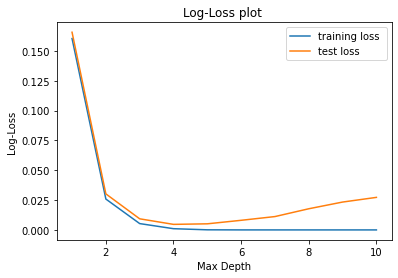

In [234]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [ ]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(GradientBoostingClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

In [ ]:
clf_gb = GradientBoostingClassifier( max_depth=4, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gb, X_train, y_train.values.ravel(), cv=10)))

In [235]:
clf_gb = GradientBoostingClassifier( max_depth=4, random_state = 42)

clf_gb.fit(X_train, y_train.values.ravel())

GradientBoostingClassifier(max_depth=4, random_state=42)

In [236]:
y_pred_gb = clf_gb.predict(X_test)

In [237]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 0.9984


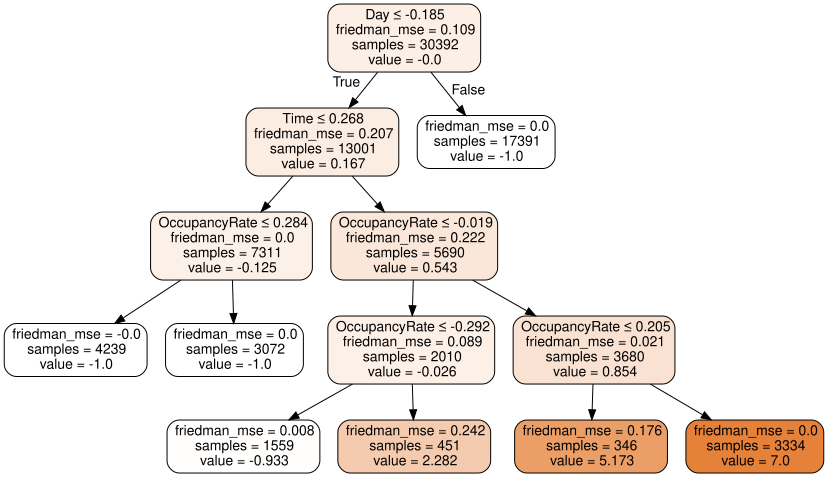

In [238]:
dot_data = tree.export_graphviz(clf_gb.estimators_[0, 0], out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [239]:
cm = confusion_matrix(y_test, y_pred_gb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[794   0   0   0   0   0   0   0]
 [  0 947   0   1   0   0   2   0]
 [  0   0 549   0   0   0   0   1]
 [  0   1   0 773   0   0   0   0]
 [  0   0   0   0 822   0   2   0]
 [  2   0   0   0   0 809   0   0]
 [  0   0   0   0   0   0 710   0]
 [  0   0   1   0   0   0   0 777]]


[Text(0, 0.5, '3'),
 Text(0, 1.5, '5'),
 Text(0, 2.5, '6'),
 Text(0, 3.5, '0'),
 Text(0, 4.5, '1'),
 Text(0, 5.5, '4'),
 Text(0, 6.5, '7'),
 Text(0, 7.5, '2')]

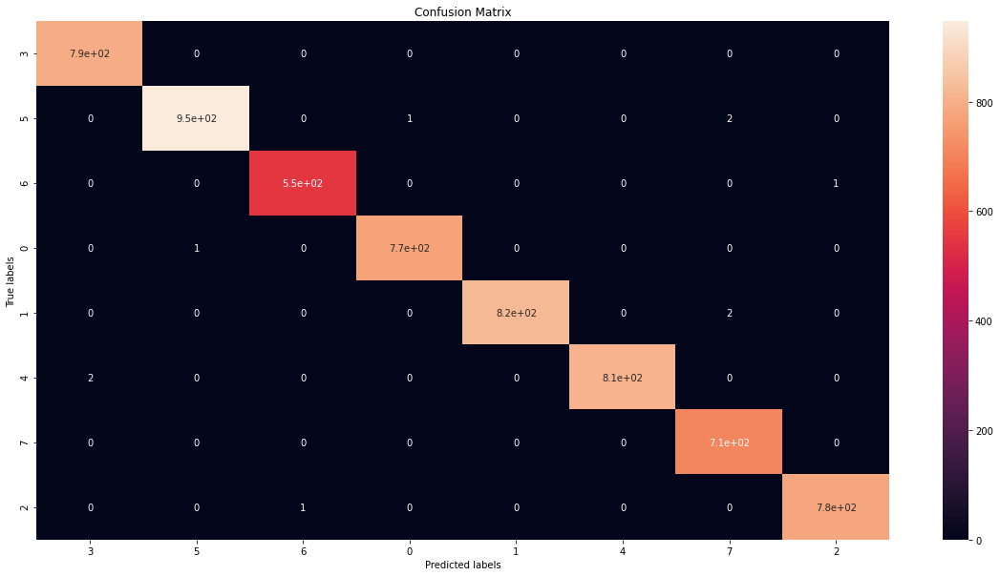

In [240]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [241]:
print(classification_report(y_test, y_pred_gb))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       794
           1       1.00      1.00      1.00       950
           2       1.00      1.00      1.00       550
           3       1.00      1.00      1.00       774
           4       1.00      1.00      1.00       824
           5       1.00      1.00      1.00       811
           6       0.99      1.00      1.00       710
           7       1.00      1.00      1.00       778

    accuracy                           1.00      6191
   macro avg       1.00      1.00      1.00      6191
weighted avg       1.00      1.00      1.00      6191



In [242]:
report = classification_report(y_test, y_pred_gb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'gmm_gb.png')

# XGBOOST

In [243]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_xgb = xgb.XGBClassifier( max_depth=i, random_state = 42, n_jobs = 4)
    
    
    clf_xgb.fit(X_train, y_train.values.ravel())
    y_pred_xgb = clf_xgb.predict_proba(X_test)
    y_pred_train_xgb = clf_xgb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_xgb))

    print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_xgb))
     
        
for i in range(1,11):
    tree_scores(i)

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:26:16] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 1
Training set score: 0.9911
Test set score: 0.9889


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:26:21] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 2
Training set score: 0.9996
Test set score: 0.9979


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:26:37] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 3
Training set score: 1.0000
Test set score: 0.9984


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:26:46] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 4
Training set score: 1.0000
Test set score: 0.9990


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:26:56] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 5
Training set score: 1.0000
Test set score: 0.9990


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:27:06] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 6
Training set score: 1.0000
Test set score: 0.9987


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:27:15] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 7
Training set score: 1.0000
Test set score: 0.9987


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:27:23] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 8
Training set score: 1.0000
Test set score: 0.9989
[20:27:32] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 9
Training set score: 1.0000
Test set score: 0.9985
[20:27:41] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 10
Training set score: 1.0000
Test set score: 0.9989


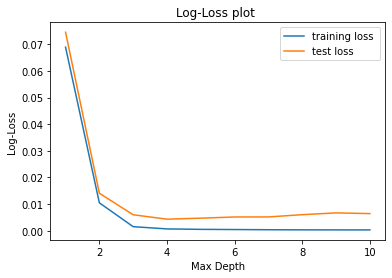

In [244]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [403]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(xgb.XGBClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[10:53:06] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
0.9911212548171882 {'max_depth': 3}


In [245]:
clf_xgb = xgb.XGBClassifier( max_depth=3, random_state = 42, n_jobs = 4)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_xgb, X_train, y_train.values.ravel(), cv=10)))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:28:22] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:28:29] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:28:35] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:28:43] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd li

In [246]:
clf_xgb = xgb.XGBClassifier( max_depth=3, random_state = 42, n_jobs = 4)

clf_xgb.fit(X_train, y_train.values.ravel())

[20:29:38] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=42, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [247]:
y_pred_xgb = clf_xgb.predict(X_test)

In [248]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 0.9984


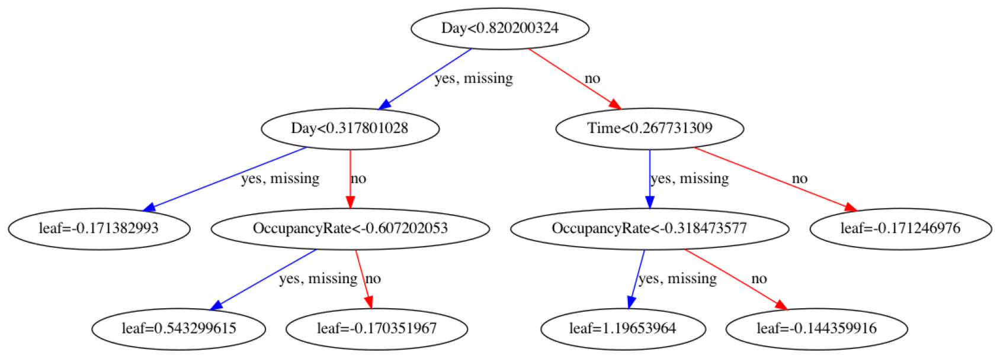

In [249]:
fig, ax = plt.subplots(figsize=(30, 30))
xgb.plot_tree(clf_xgb, num_trees=4, ax=ax)
plt.show()

In [250]:
cm = confusion_matrix(y_test, y_pred_xgb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[794   0   0   0   0   0   0   0]
 [  0 946   0   1   0   0   3   0]
 [  0   0 549   0   0   0   0   1]
 [  0   1   0 773   0   0   0   0]
 [  0   0   0   0 823   0   1   0]
 [  2   0   0   0   0 809   0   0]
 [  0   0   0   0   0   0 710   0]
 [  0   0   1   0   0   0   0 777]]


[Text(0, 0.5, '3'),
 Text(0, 1.5, '5'),
 Text(0, 2.5, '6'),
 Text(0, 3.5, '0'),
 Text(0, 4.5, '1'),
 Text(0, 5.5, '4'),
 Text(0, 6.5, '7'),
 Text(0, 7.5, '2')]

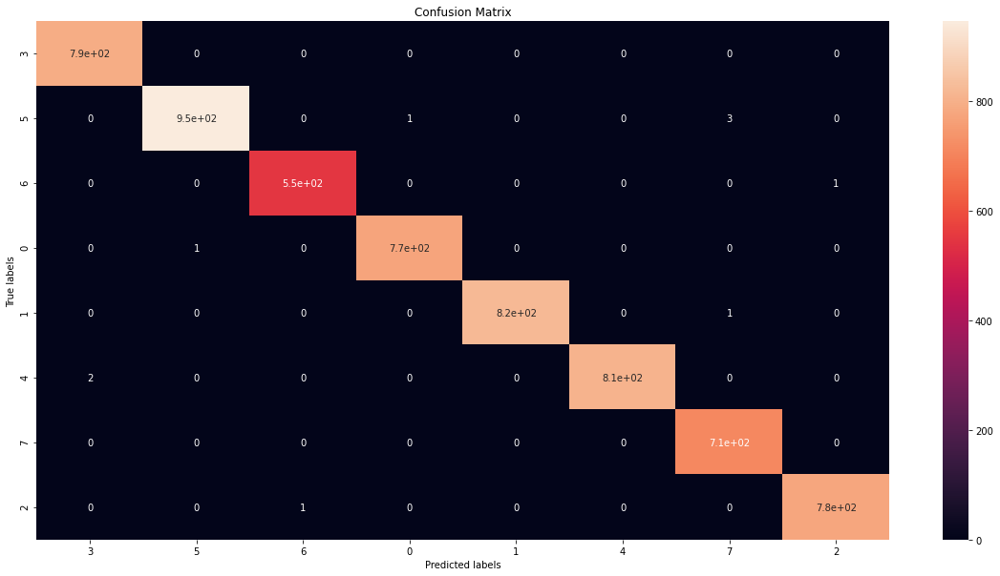

In [251]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [252]:

print(classification_report(y_test, y_pred_xgb))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       794
           1       1.00      1.00      1.00       950
           2       1.00      1.00      1.00       550
           3       1.00      1.00      1.00       774
           4       1.00      1.00      1.00       824
           5       1.00      1.00      1.00       811
           6       0.99      1.00      1.00       710
           7       1.00      1.00      1.00       778

    accuracy                           1.00      6191
   macro avg       1.00      1.00      1.00      6191
weighted avg       1.00      1.00      1.00      6191



In [253]:
import dataframe_image as dfi 
report = classification_report(y_test, y_pred_xgb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'gmm_xgb.png')

<h3 id="Kmeans_Dataset">
3.4 KMeans Dataset
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#Kmeans_Dataset">¶</a>
</h3>

### 3.4.1 Decision Tree

In [254]:
data_kmeans.describe()

,OccupancyRate,Time,Day,kmeans
count,30953.000000,30953.000000,30953.000000,30953.000000
mean,-0.016325,-0.004991,0.006449,1.043776
std,0.973342,1.009943,1.000212,0.841498
min,-1.843117,-1.625080,-1.440596,0.000000
25%,-0.859861,-0.867955,-0.938197,0.000000
50%,-0.079262,-0.110831,0.066601,1.000000
75%,0.789340,0.646294,1.071400,2.000000
max,1.909766,1.403418,1.573799,2.000000


In [255]:
data_kmeans.drop_duplicates()

,OccupancyRate,Time,Day,kmeans
0,-1.446365,-1.625080,-0.938197,0
1,-1.426852,-1.625080,-0.938197,0
2,-1.322786,-1.625080,-0.938197,0
3,-1.147175,-0.867955,-0.938197,0
4,-0.867497,-0.867955,-0.938197,0
...,...,...,...,...
34951,1.122052,0.646294,-1.440596,2
34952,1.063413,1.403418,-1.440596,2
34953,0.955908,1.403418,-1.440596,2
34954,0.738945,1.403418,-1.440596,2


In [256]:
for col in data_kmeans.columns:
    print(data_kmeans[col].value_counts())

 1.909766    20
-1.167598    20
-1.142579    18
 0.408613    18
 1.159189    18
             ..
 0.350235     1
 1.812792     1
 1.078797     1
 1.580329     1
-0.100334     1
Name: OccupancyRate, Length: 14217, dtype: int64
-0.867955    7109
 0.646294    6742
-0.110831    6645
 1.403418    6402
-1.625080    4055
Name: Time, dtype: int64
-0.435798    4723
-0.938197    4720
-1.440596    4715
 0.066601    4387
 0.569001    4262
 1.071400    4098
 1.573799    4048
Name: Day, dtype: int64
2    11666
0    10311
1     8976
Name: kmeans, dtype: int64


In [257]:
X = data_kmeans.drop(['kmeans'], axis = 1)
y = data_kmeans['kmeans']

In [258]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 42, stratify=y)

In [259]:
print(y_test.value_counts()) #we secured the 20% in the classes represenation

2    2334
0    2062
1    1795
Name: kmeans, dtype: int64


In [260]:
sm = SMOTE(random_state = 42)
           
X_train, y_train = sm.fit_sample(X_train, y_train) 

In [261]:
print(y_train.value_counts())

2    9332
1    9332
0    9332
Name: kmeans, dtype: int64


# GINI CRITERION

In [263]:
training_scores = []
test_scores = []

def tree_scores(i):
    clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=i, random_state = 42)
    
    
    clf_gini.fit(X_train, y_train)
    y_pred_gini = clf_gini.predict_proba(X_test)
    y_pred_train_gini = clf_gini.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))
    training_scores.append(log_loss(y_train, y_pred_train_gini))

    print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))
    test_scores.append(log_loss(y_test, y_pred_gini))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.6299
Test set score: 0.5834
Max Depth: 2
Training set score: 0.8906
Test set score: 0.8955
Max Depth: 3
Training set score: 0.8950
Test set score: 0.8987
Max Depth: 4
Training set score: 0.9283
Test set score: 0.9268
Max Depth: 5
Training set score: 0.9641
Test set score: 0.9583
Max Depth: 6
Training set score: 0.9817
Test set score: 0.9771
Max Depth: 7
Training set score: 0.9902
Test set score: 0.9882
Max Depth: 8
Training set score: 0.9997
Test set score: 0.9979
Max Depth: 9
Training set score: 1.0000
Test set score: 0.9985
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9984


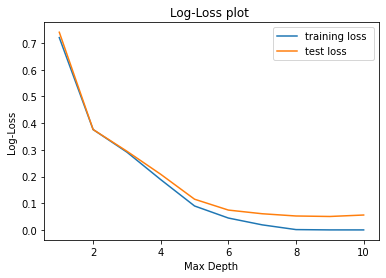

In [264]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_scores, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_scores, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [265]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='gini', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

0.9983211861812059 {'max_depth': 10}


In [266]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=8, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gini, X_train, y_train, cv=10)))

Cross-Validation Score: 0.9982854973715103


In [267]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=8, random_state = 42)

clf_gini.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=8, random_state=42)

In [268]:
y_pred_gini = clf_gini.predict(X_test)

In [269]:
print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))

Training set score: 0.9997
Test set score: 0.9979


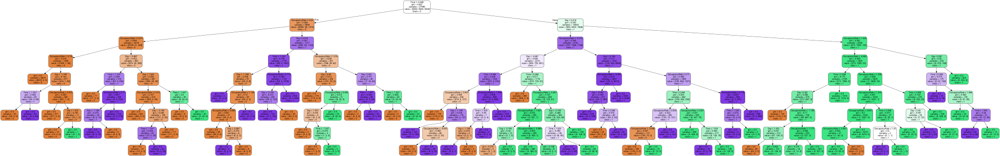

In [270]:
dot_data = tree.export_graphviz(clf_gini, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [271]:
cf_matrix = confusion_matrix(y_test, y_pred_gini)

cf_matrix

array([[2054,    6,    2],
       [   2, 1790,    3],
       [   0,    0, 2334]])

[Text(0, 0.5, '1'), Text(0, 1.5, '0'), Text(0, 2.5, '2')]

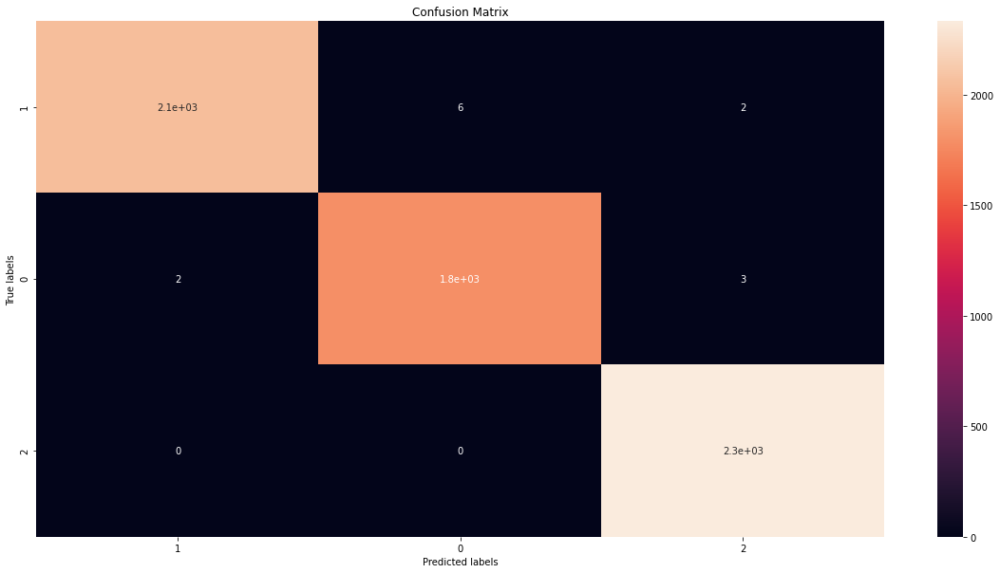

In [272]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [273]:
print(classification_report(y_test, y_pred_gini))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2062
           1       1.00      1.00      1.00      1795
           2       1.00      1.00      1.00      2334

    accuracy                           1.00      6191
   macro avg       1.00      1.00      1.00      6191
weighted avg       1.00      1.00      1.00      6191



In [274]:
report = classification_report(y_test, y_pred_gini, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'kmeans_gini.png')

# ENTROPY

In [275]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=i, random_state = 42)
    
    
    clf_en.fit(X_train, y_train)
    y_pred_en = clf_en.predict_proba(X_test)
    y_pred_train_en = clf_en.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_en))

    print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_en))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.6299
Test set score: 0.5834
Max Depth: 2
Training set score: 0.8761
Test set score: 0.8811
Max Depth: 3
Training set score: 0.8902
Test set score: 0.8942
Max Depth: 4
Training set score: 0.9071
Test set score: 0.9105
Max Depth: 5
Training set score: 0.9503
Test set score: 0.9444
Max Depth: 6
Training set score: 0.9783
Test set score: 0.9706
Max Depth: 7
Training set score: 0.9862
Test set score: 0.9824
Max Depth: 8
Training set score: 0.9966
Test set score: 0.9955
Max Depth: 9
Training set score: 1.0000
Test set score: 0.9989
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9989


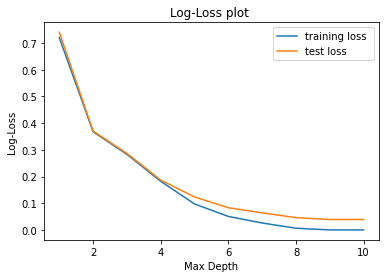

In [276]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [277]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='entropy', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

0.9987855293037022 {'max_depth': 9}


In [278]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=8, random_state = 42)

clf_en.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=8, random_state=42)

In [279]:
y_pred_en = clf_en.predict(X_test)

In [280]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))

Training set score: 0.9966
Test set score: 0.9955


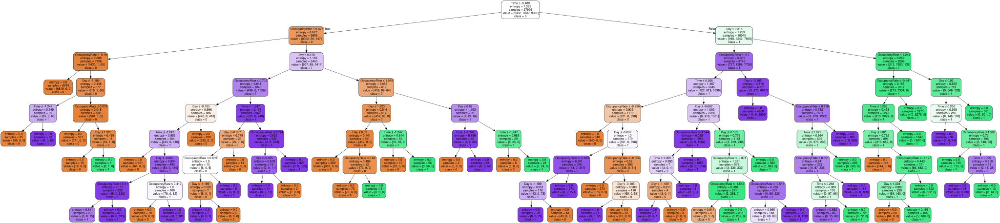

In [281]:
dot_data = tree.export_graphviz(clf_en, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [282]:
cm = confusion_matrix(y_test, y_pred_en)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[2055    4    3]
 [   2 1774   19]
 [   0    0 2334]]


[Text(0, 0.5, '1'), Text(0, 1.5, '0'), Text(0, 2.5, '2')]

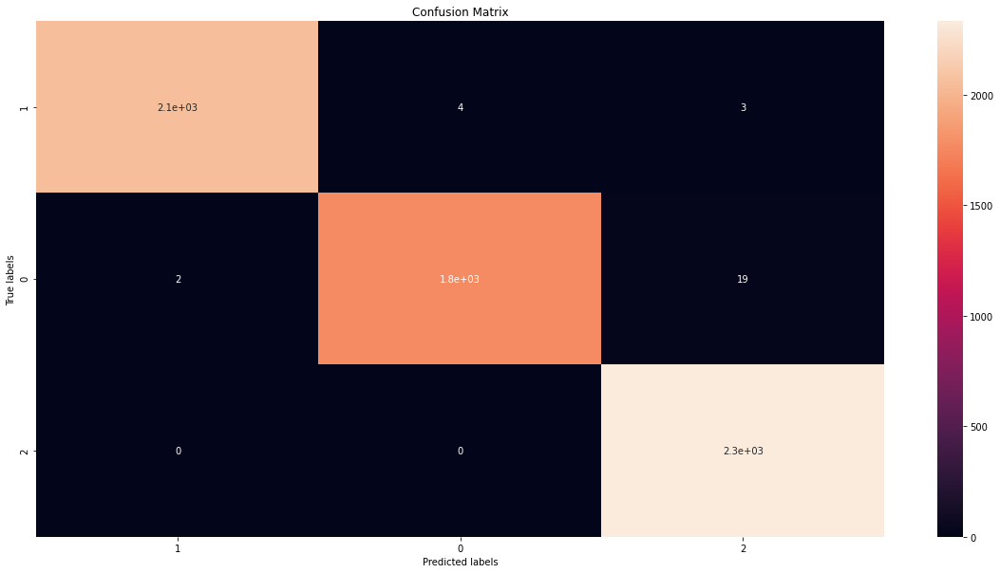

In [283]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [284]:
print(classification_report(y_test, y_pred_en))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2062
           1       1.00      0.99      0.99      1795
           2       0.99      1.00      1.00      2334

    accuracy                           1.00      6191
   macro avg       1.00      0.99      1.00      6191
weighted avg       1.00      1.00      1.00      6191



In [285]:
report = classification_report(y_test, y_pred_en, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'kmeans_en.png')

# GRADIENT BOOSTING

In [286]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_gb = GradientBoostingClassifier( max_depth=i, random_state = 42)
    
    
    clf_gb.fit(X_train, y_train.values.ravel())
    y_pred_gb = clf_gb.predict_proba(X_test)
    y_pred_train_gb = clf_gb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_gb))

    print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_gb))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.9685
Test set score: 0.9688
Max Depth: 2
Training set score: 0.9920
Test set score: 0.9910
Max Depth: 3
Training set score: 0.9989
Test set score: 0.9979
Max Depth: 4
Training set score: 1.0000
Test set score: 0.9990
Max Depth: 5
Training set score: 1.0000
Test set score: 0.9989
Max Depth: 6
Training set score: 1.0000
Test set score: 0.9987
Max Depth: 7
Training set score: 1.0000
Test set score: 0.9989
Max Depth: 8
Training set score: 1.0000
Test set score: 0.9990
Max Depth: 9
Training set score: 1.0000
Test set score: 0.9989
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9987


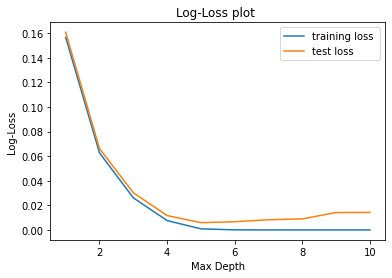

In [287]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [391]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(GradientBoostingClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

0.989852540966204 {'max_depth': 4}


In [288]:
clf_gb = GradientBoostingClassifier( max_depth=5, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gb, X_train, y_train.values.ravel(), cv=10)))

Cross-Validation Score: 0.9989641836370133


In [289]:
clf_gb = GradientBoostingClassifier( max_depth=5, random_state = 42)

clf_gb.fit(X_train, y_train.values.ravel())

GradientBoostingClassifier(max_depth=5, random_state=42)

In [290]:
y_pred_gb = clf_gb.predict(X_test)

In [291]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 0.9989


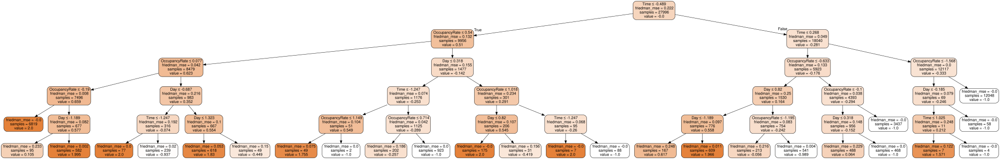

In [292]:
dot_data = tree.export_graphviz(clf_gb.estimators_[0, 0], out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [293]:
cm = confusion_matrix(y_test, y_pred_gb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[2059    2    1]
 [   1 1791    3]
 [   0    0 2334]]


[Text(0, 0.5, '1'), Text(0, 1.5, '0'), Text(0, 2.5, '2')]

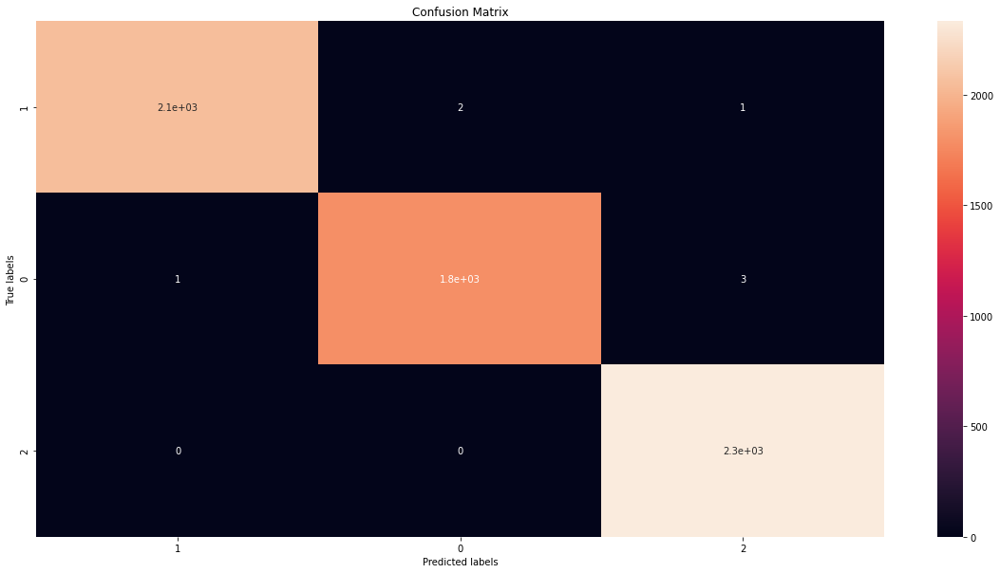

In [294]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [295]:
print(classification_report(y_test, y_pred_gb))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2062
           1       1.00      1.00      1.00      1795
           2       1.00      1.00      1.00      2334

    accuracy                           1.00      6191
   macro avg       1.00      1.00      1.00      6191
weighted avg       1.00      1.00      1.00      6191



In [296]:
report = classification_report(y_test, y_pred_gb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'kmeans_gb.png')

# XGBOOST

In [297]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_xgb = xgb.XGBClassifier( max_depth=i, random_state = 42, n_jobs = 4)
    
    
    clf_xgb.fit(X_train, y_train.values.ravel())
    y_pred_xgb = clf_xgb.predict_proba(X_test)
    y_pred_train_xgb = clf_xgb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_xgb))

    print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_xgb))
     
        
for i in range(1,11):
    tree_scores(i)

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:40:42] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 1
Training set score: 0.9853
Test set score: 0.9835
[20:40:44] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 2
Training set score: 0.9994
Test set score: 0.9981
[20:40:46] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 3
Training set score: 0.9999
Test set score: 0.9992
[20:40:49] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 4
Training set score: 1.0000
Test set score: 0.9989
[20:40:55] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 5
Training set score: 1.0000
Test set score: 0.9992
[20:40:59] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 6
Training set score: 1.0000
Test set score: 0.9990
[20:41:05] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 7
Training set score: 1.0000
Test set score: 0.9989
[20:41:09] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 8
Training set score: 1.0000
Test set score: 0.9989
[20:41:13] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Max Depth: 9
Training set score: 1.0000
Test set score: 0.9989


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:41:19] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9989


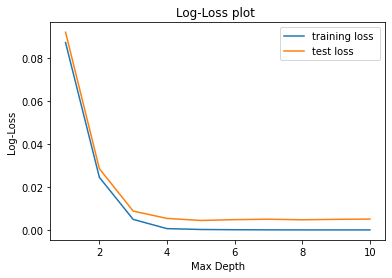

In [298]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [299]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(xgb.XGBClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:44:10] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
0.9989284119613198 {'max_depth': 6}


In [300]:
clf_xgb = xgb.XGBClassifier( max_depth=4, random_state = 42, n_jobs = 4)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_xgb, X_train, y_train.values.ravel(), cv=10)))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:888: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[20:44:27] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:44:30] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:44:34] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:44:37] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd li

In [301]:
clf_xgb = xgb.XGBClassifier( max_depth=4, random_state = 42, n_jobs = 4)

clf_xgb.fit(X_train, y_train.values.ravel())

[20:45:04] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=4,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=42, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [302]:
y_pred_xgb = clf_xgb.predict(X_test)

In [303]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 0.9989


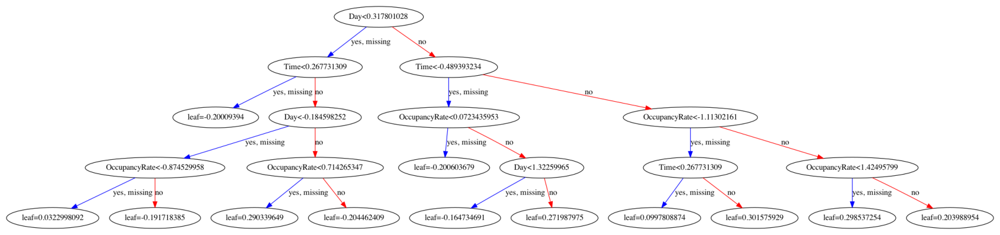

In [304]:
fig, ax = plt.subplots(figsize=(30, 30))
xgb.plot_tree(clf_xgb, num_trees=4, ax=ax)
plt.show()

In [305]:
cm = confusion_matrix(y_test, y_pred_xgb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[2060    1    1]
 [   1 1790    4]
 [   0    0 2334]]


[Text(0, 0.5, '1'), Text(0, 1.5, '0'), Text(0, 2.5, '2')]

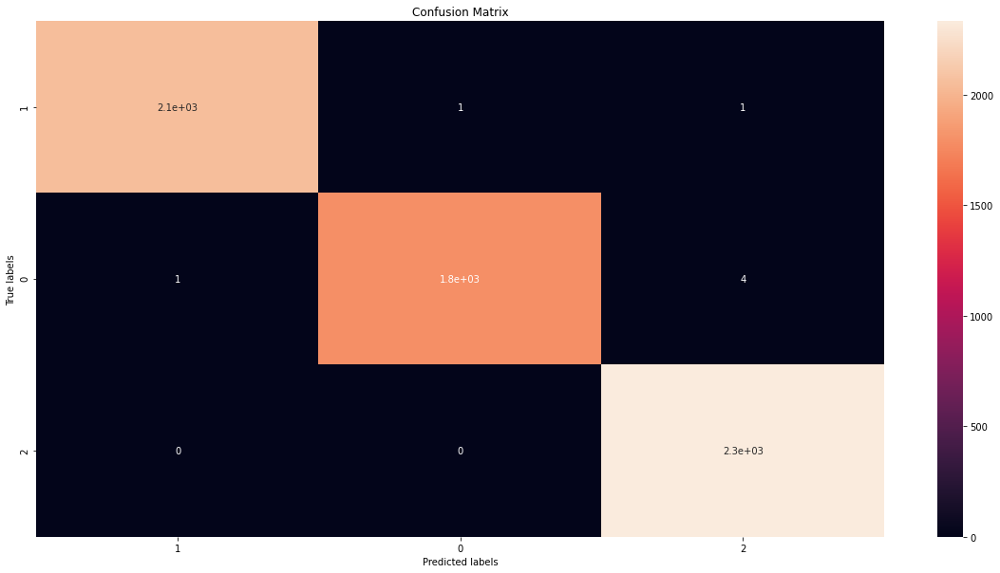

In [306]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [307]:
print(classification_report(y_test, y_pred_xgb))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2062
           1       1.00      1.00      1.00      1795
           2       1.00      1.00      1.00      2334

    accuracy                           1.00      6191
   macro avg       1.00      1.00      1.00      6191
weighted avg       1.00      1.00      1.00      6191



In [308]:
report = classification_report(y_test, y_pred_xgb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'kmeans_xgb.png')